In [1]:
'''
projects based on the assignments in the GAN course provided by deeplearning.ai

'''

import torch
from torch import nn 
from tqdm.auto import tqdm 
from torchvision import transforms
from torchvision.datasets import MNIST
from torchvision.utils import make_grid
from torch.utils.data import DataLoader
import matplotlib.pyplot as plt
torch.manual_seed(0)

def show_tensor_images(image_tensor, num_images = 25, size=(1,28,28)):
    image_unflat = image_tensor.detach().cpu().view(-1, *size)
    image_grid = make_grid(image_unflat[:num_images], nrow = 5)
    plt.imshow(image_grid.permute(1,2,0).squeeze())
    plt.show()

In [2]:
def get_generator_block(input_dim, output_dim):
    return nn.Sequential(
        nn.Linear(input_dim, output_dim),
        nn.BatchNorm1d(output_dim),
        nn.ReLU(inplace = True)
    )

In [3]:
class Generator(nn.Module):
    def __init__(self, z_dim = 10, im_dim = 784, hidden_dim = 128):
        super(Generator, self).__init__()

        self.gen = nn.Sequential(
            get_generator_block(z_dim, hidden_dim),
            get_generator_block(hidden_dim, hidden_dim*2),
            get_generator_block(hidden_dim * 2, hidden_dim*4),
            get_generator_block(hidden_dim*4, hidden_dim *8),
            nn.Linear(hidden_dim * 8, im_dim),
            nn.Sigmoid()

        )

    def forward(self, noise):
        return self.gen(noise)
    
    def get_gen(self):

        return self.gen

In [4]:
def get_noise(n_samples, z_dim, device = 'cpu'):

    return torch.randn(n_samples, z_dim, device = device)

In [5]:
def get_discriminator_block(input_dim, output_dim):
    return nn.Sequential(
        nn.Linear(input_dim, output_dim),
        nn.LeakyReLU(0.2, inplace =True)

    )


In [12]:
class Discriminator(nn.Module):

    def __init__(self, im_dim= 784, hidden_dim = 128):
        super(Discriminator, self).__init__()
        self.disc = nn.Sequential(
            get_discriminator_block(im_dim, hidden_dim*4),
            get_discriminator_block(hidden_dim * 4, hidden_dim *2),
            get_discriminator_block(hidden_dim*2, hidden_dim),
            nn.Linear(hidden_dim, 1)
        )

    def forward(self, image):
        return self.disc(image)
    
    def get_disc(self):
        return self.disc 
    

In [15]:
criterion = nn.BCEWithLogitsLoss()
n_epochs = 200
z_dim = 64
display_step = 500
batch_size = 128
lr = 0.00001
device = 'cuda'
dataloader = DataLoader(MNIST('.', download=True, transform = transforms.ToTensor()),
                        batch_size = batch_size, shuffle = True)

In [16]:
gen = Generator(z_dim).to(device)
gen_opt = torch.optim.Adam(gen.parameters(), lr=lr)
disc = Discriminator().to(device)
disc_opt = torch.optim.Adam(disc.parameters(), lr = lr)

In [17]:
def get_disc_loss(gen, disc, criterion, real, num_images, z_dim, device):
    noise = get_noise(num_images, z_dim, device = device)
    fake = gen(noise)
    disc_fake_pred = disc(fake.detach())
    disc_fake_loss = criterion(disc_fake_pred, torch.zeros_like(disc_fake_pred))
    disc_real_pred = disc(real)
    disc_real_loss = criterion(disc_real_pred, torch.ones_like(disc_real_pred))
    disc_loss = (disc_fake_loss + disc_real_loss) / 2

    return disc_loss

In [18]:
def get_gen_loss(gen, disc, criterion, num_images, z_dim, device):
    noise = get_noise(num_images, z_dim, device = device)
    fake = gen(noise)
    disc_fake_pred = disc(fake)
    gen_loss = criterion(disc_fake_pred, torch.ones_like(disc_fake_pred))
    return gen_loss

  6%|▌         | 29/469 [00:00<00:09, 45.25it/s]

Step 500: Generator loss: 3.9214487357139642, discriminator loss: 0.08564186600595708


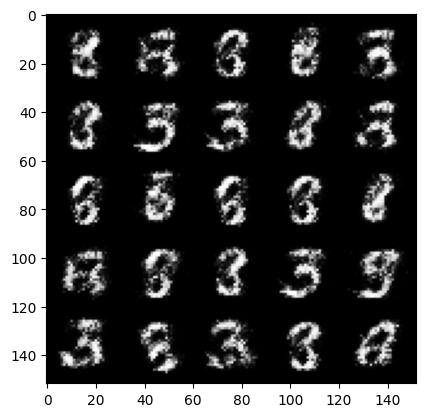

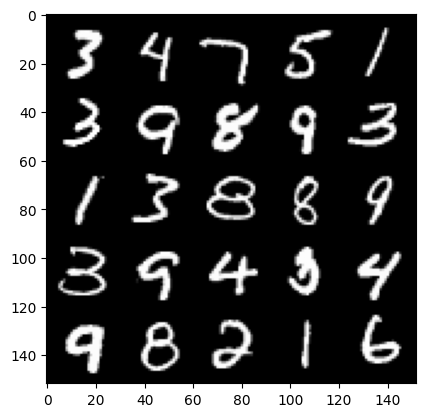

 13%|█▎        | 60/469 [00:01<00:09, 45.20it/s]

Step 1000: Generator loss: 3.928034509181976, discriminator loss: 0.07594711329787973


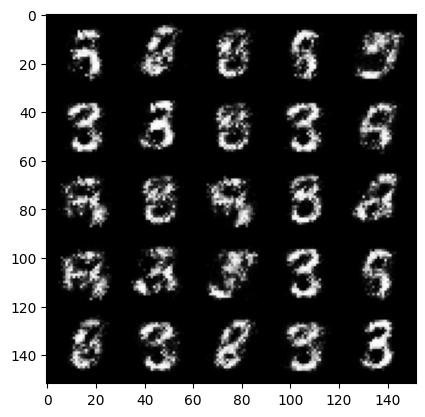

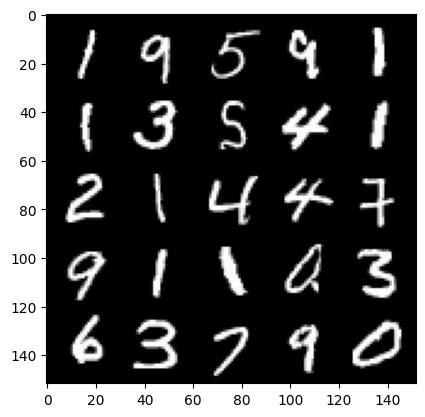

 19%|█▉        | 90/469 [00:02<00:08, 46.04it/s]

Step 1500: Generator loss: 3.671391972064976, discriminator loss: 0.09368452671915299


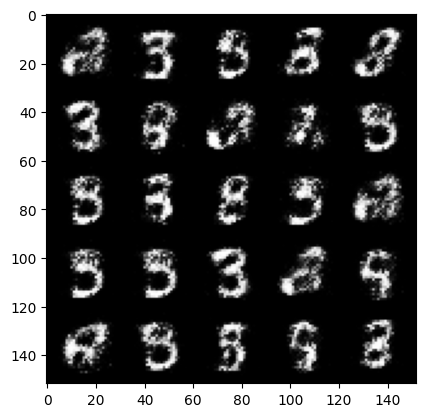

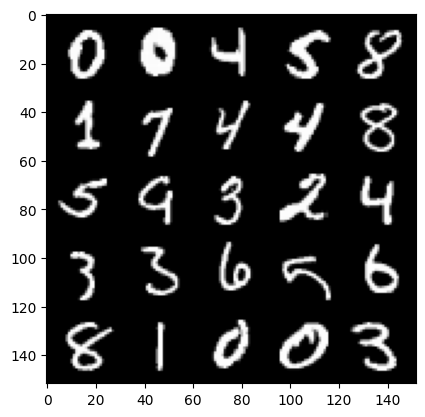

 26%|██▌       | 120/469 [00:02<00:07, 45.59it/s]

Step 2000: Generator loss: 3.7909701161384595, discriminator loss: 0.09983719711005687


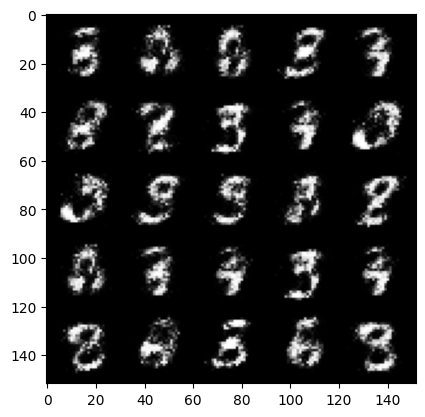

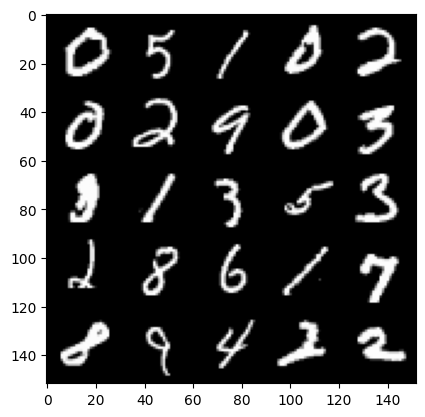

 33%|███▎      | 154/469 [00:03<00:07, 43.45it/s]

Step 2500: Generator loss: 3.779251042366029, discriminator loss: 0.09540838392078871


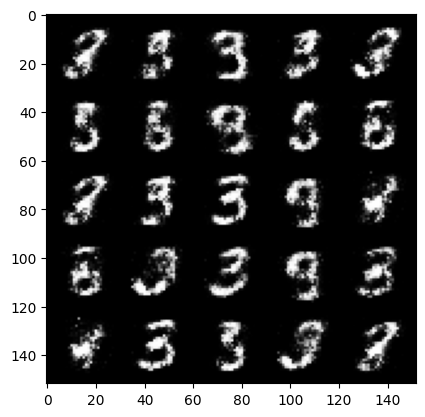

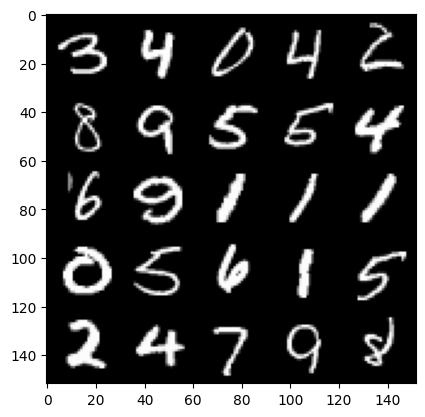

 39%|███▉      | 184/469 [00:04<00:06, 46.31it/s]

Step 3000: Generator loss: 3.7812408895492524, discriminator loss: 0.09509261207282539


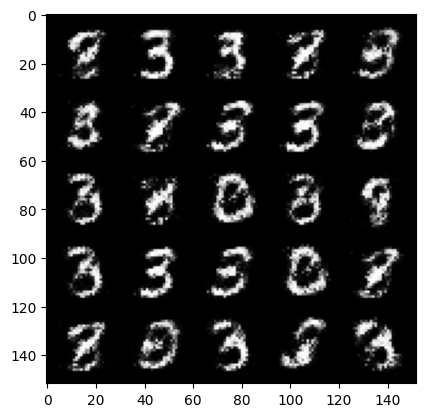

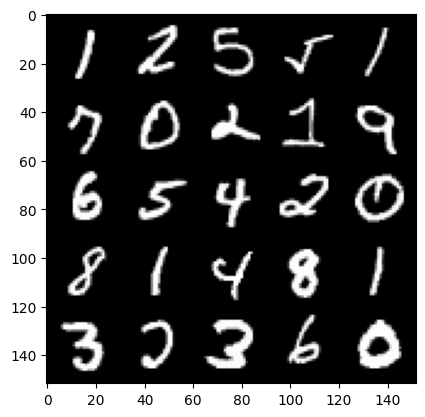

 45%|████▌     | 213/469 [00:04<00:05, 46.89it/s]

Step 3500: Generator loss: 3.788733535766599, discriminator loss: 0.10204800451546898


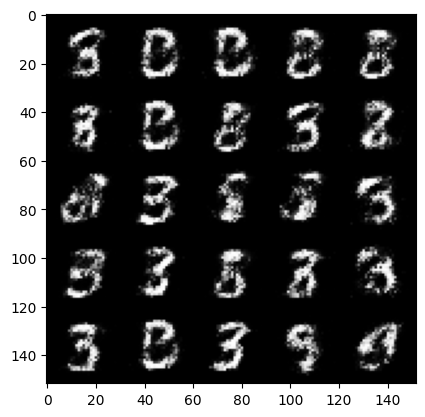

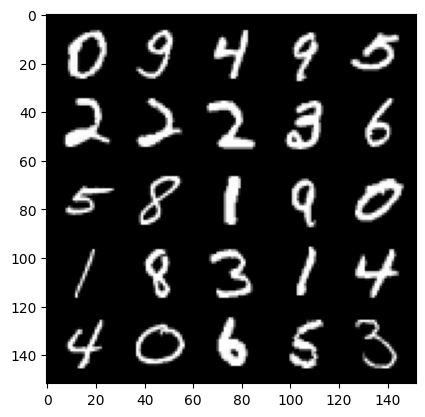

 52%|█████▏    | 245/469 [00:05<00:04, 46.44it/s]

Step 4000: Generator loss: 3.7055157084465034, discriminator loss: 0.1131625794023275


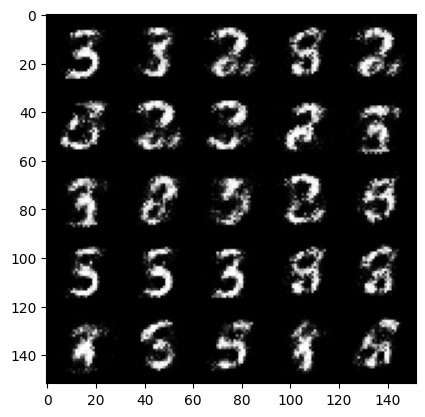

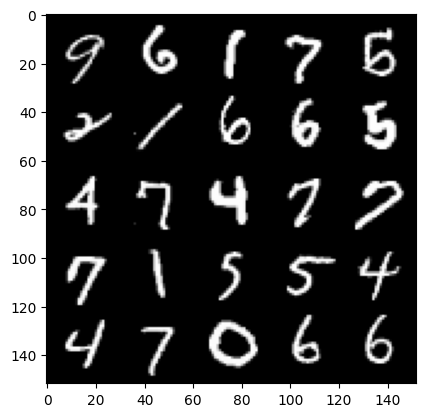

 59%|█████▊    | 275/469 [00:06<00:04, 47.04it/s]

Step 4500: Generator loss: 3.69419082927704, discriminator loss: 0.10958899576961986


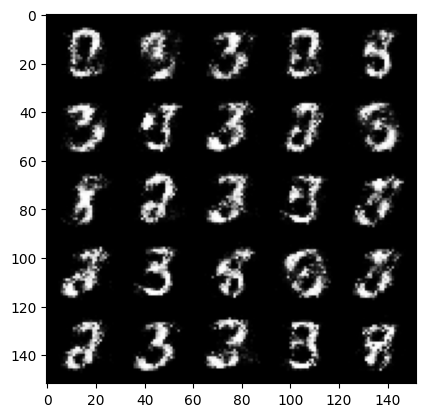

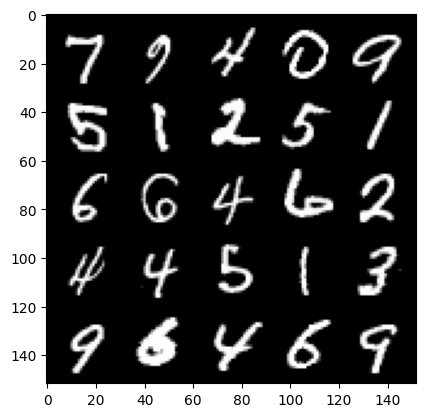

 66%|██████▌   | 310/469 [00:06<00:03, 46.43it/s]

Step 5000: Generator loss: 3.6457926478385922, discriminator loss: 0.1102708536460996


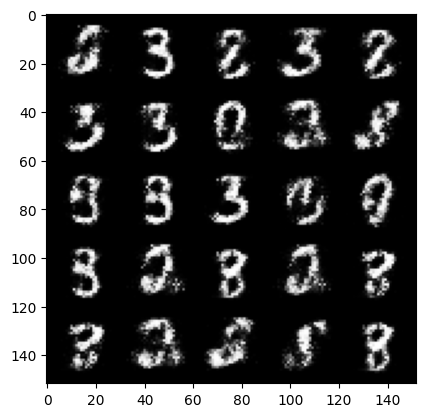

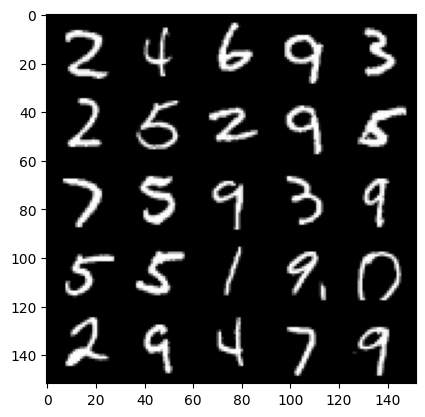

 72%|███████▏  | 340/469 [00:07<00:02, 45.55it/s]

Step 5500: Generator loss: 3.668104443550111, discriminator loss: 0.12953684013336908


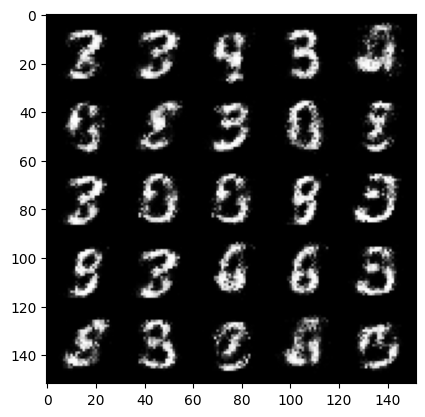

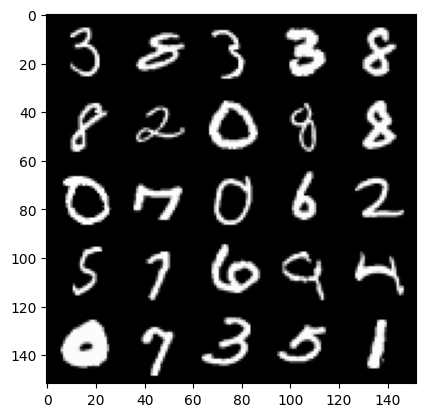

 79%|███████▉  | 370/469 [00:07<00:02, 47.08it/s]

Step 6000: Generator loss: 3.6015623750686654, discriminator loss: 0.14175617137551327


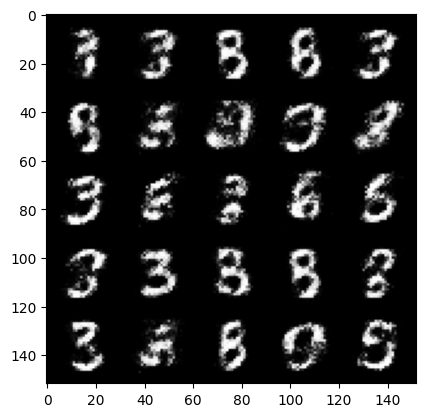

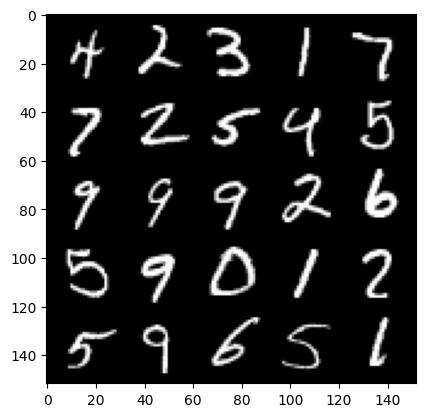

 85%|████████▌ | 400/469 [00:08<00:01, 45.80it/s]

Step 6500: Generator loss: 3.526867319107056, discriminator loss: 0.13116931863129142


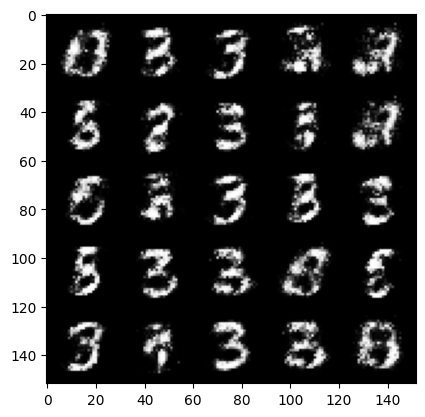

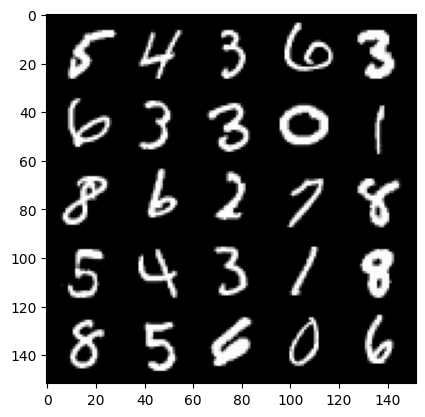

 93%|█████████▎| 434/469 [00:09<00:00, 46.53it/s]

Step 7000: Generator loss: 3.4957785744667045, discriminator loss: 0.13964700379967687


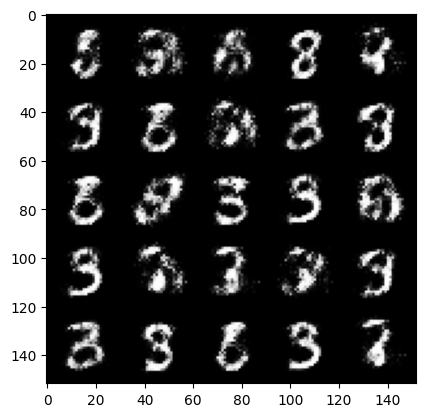

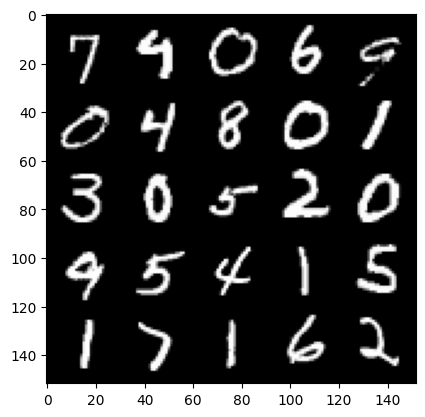

 99%|█████████▉| 465/469 [00:10<00:00, 47.54it/s]

Step 7500: Generator loss: 3.5245681848526, discriminator loss: 0.13677204574644555


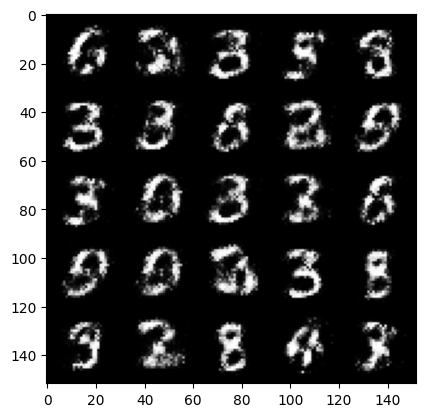

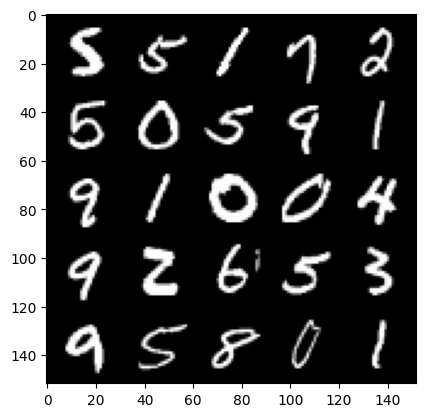

  5%|▌         | 25/469 [00:00<00:09, 44.52it/s]

Step 8000: Generator loss: 3.40482866811752, discriminator loss: 0.1383078137487172


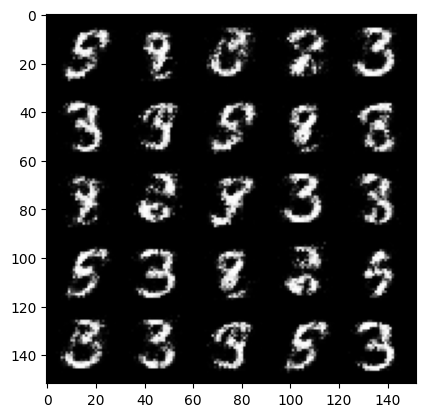

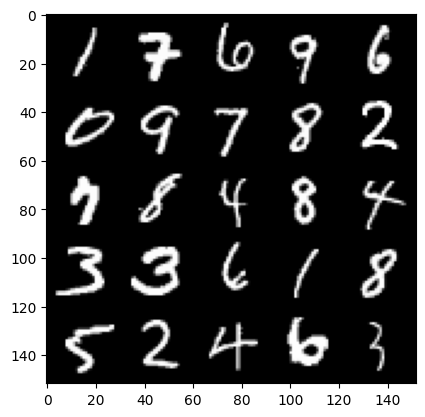

 12%|█▏        | 55/469 [00:01<00:09, 45.84it/s]

Step 8500: Generator loss: 3.362703672885893, discriminator loss: 0.14643632246553911


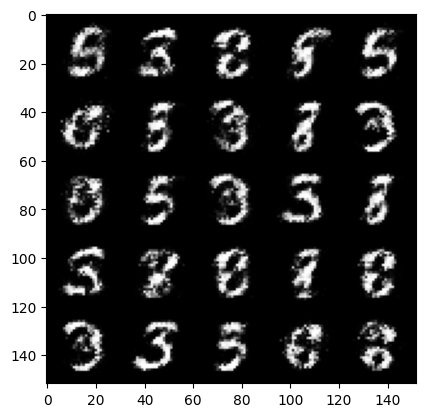

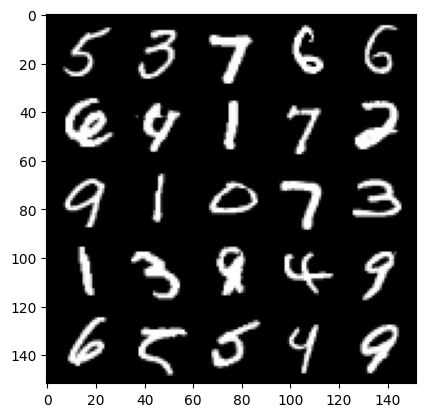

 18%|█▊        | 85/469 [00:01<00:08, 46.04it/s]

Step 9000: Generator loss: 3.311175751686096, discriminator loss: 0.15021059671044334


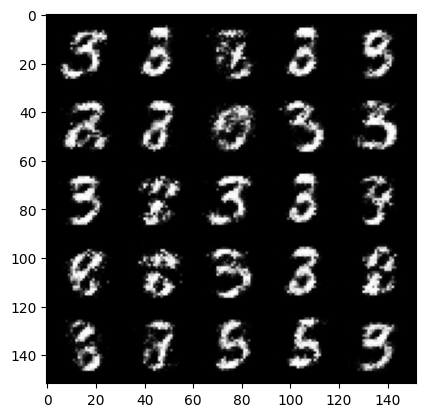

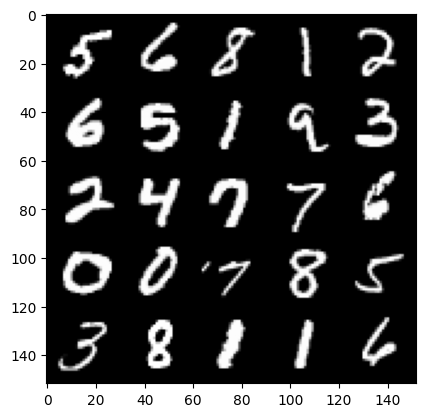

 26%|██▌       | 120/469 [00:02<00:07, 45.50it/s]

Step 9500: Generator loss: 3.341317649841312, discriminator loss: 0.1513673287332058


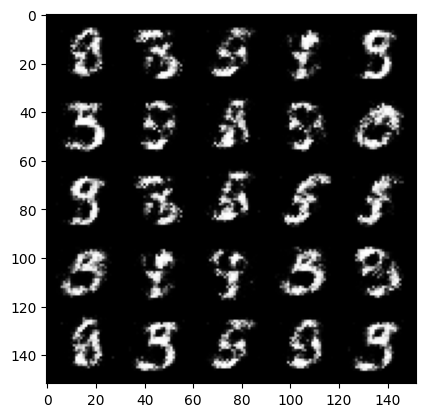

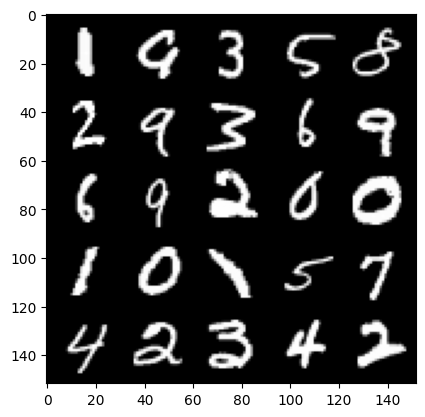

 32%|███▏      | 149/469 [00:03<00:06, 47.08it/s]

Step 10000: Generator loss: 3.28756446504593, discriminator loss: 0.14975087806582446


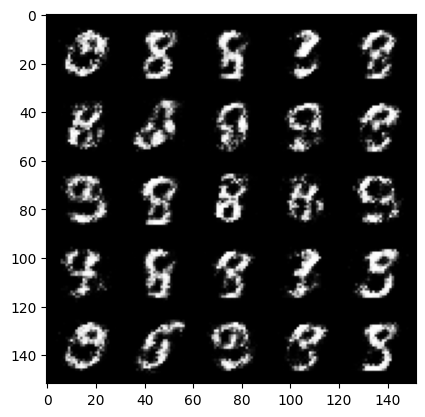

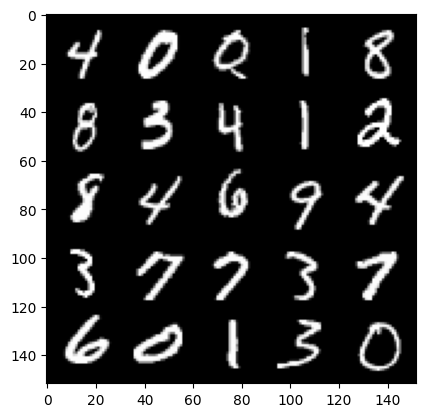

 38%|███▊      | 179/469 [00:03<00:06, 47.49it/s]

Step 10500: Generator loss: 3.24483881187439, discriminator loss: 0.15645936553180226


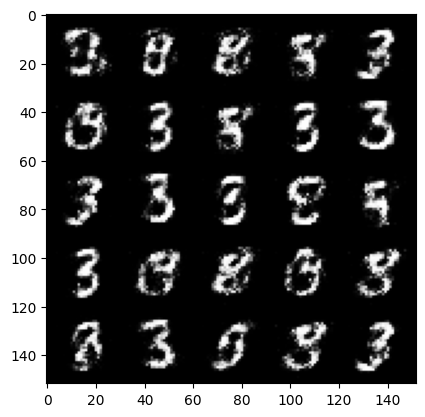

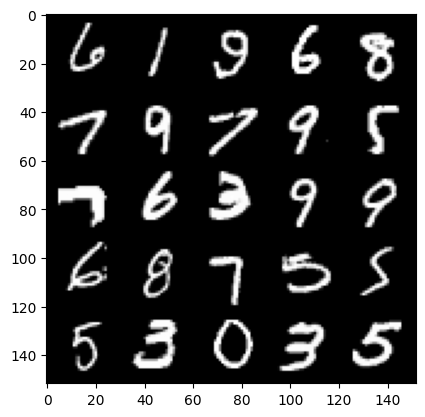

 45%|████▍     | 210/469 [00:04<00:05, 44.91it/s]

Step 11000: Generator loss: 3.1671274766921993, discriminator loss: 0.166523076236248


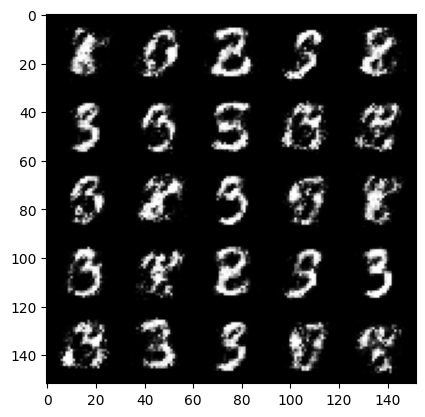

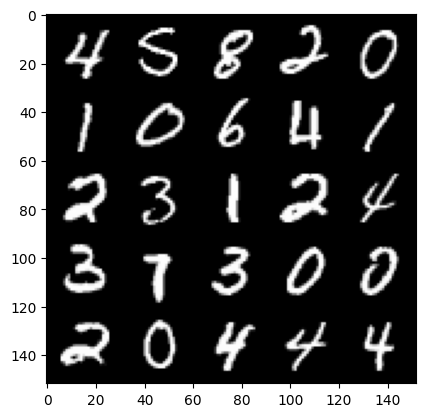

 51%|█████     | 240/469 [00:05<00:05, 44.98it/s]

Step 11500: Generator loss: 3.337757653236386, discriminator loss: 0.16771931013464952


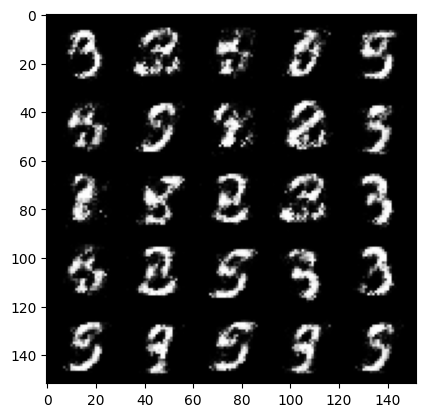

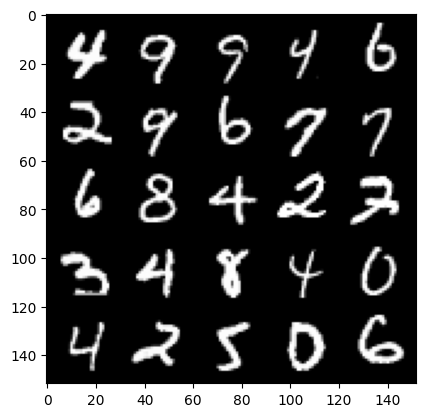

 58%|█████▊    | 273/469 [00:06<00:04, 45.02it/s]

Step 12000: Generator loss: 3.1868872251510623, discriminator loss: 0.1762419964671135


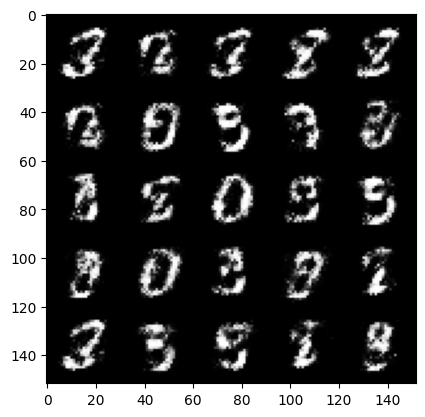

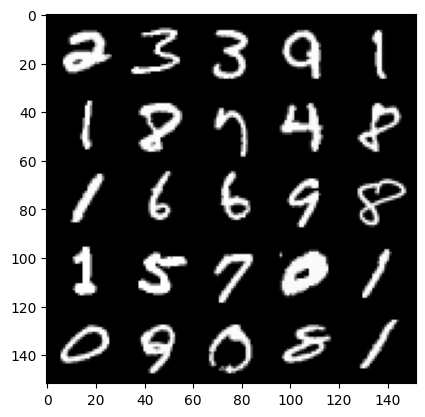

 65%|██████▌   | 305/469 [00:06<00:03, 45.74it/s]

Step 12500: Generator loss: 3.0100027508735683, discriminator loss: 0.19542875291407108


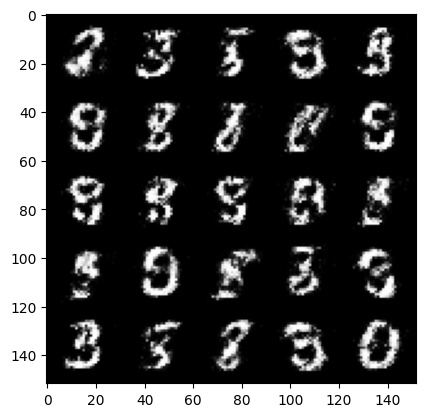

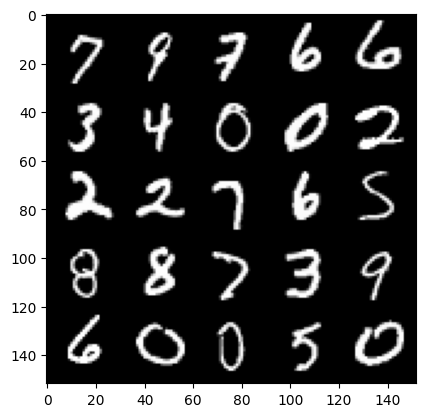

 71%|███████   | 334/469 [00:07<00:03, 41.62it/s]

Step 13000: Generator loss: 3.0956146192550666, discriminator loss: 0.17273880732059468


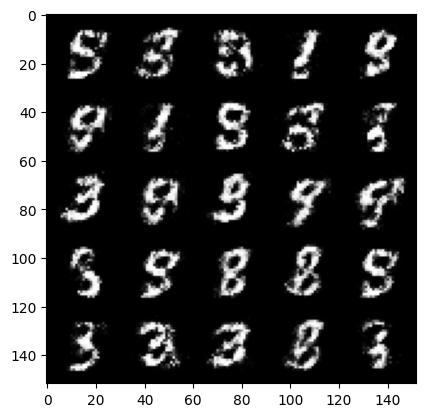

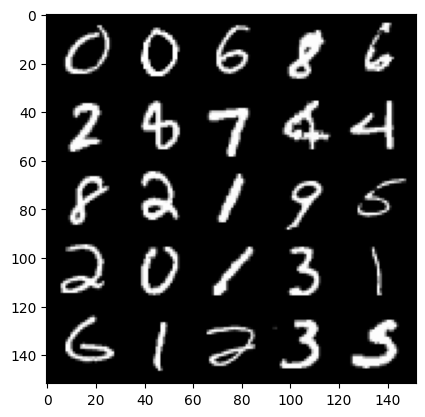

 78%|███████▊  | 367/469 [00:08<00:02, 43.77it/s]

Step 13500: Generator loss: 2.8980074877738957, discriminator loss: 0.1951351223289967


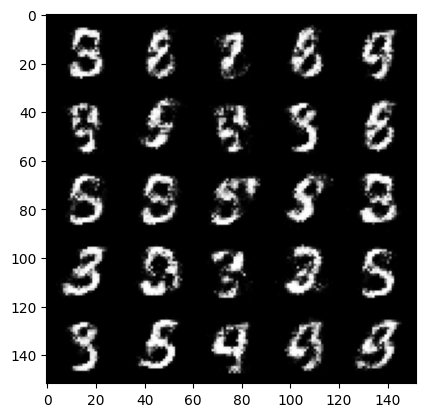

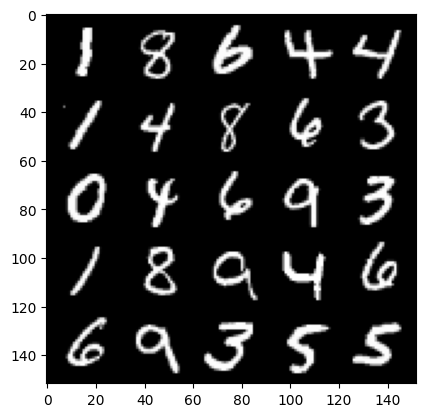

 84%|████████▍ | 395/469 [00:08<00:01, 46.32it/s]

Step 14000: Generator loss: 2.80882808494568, discriminator loss: 0.2052890749424696


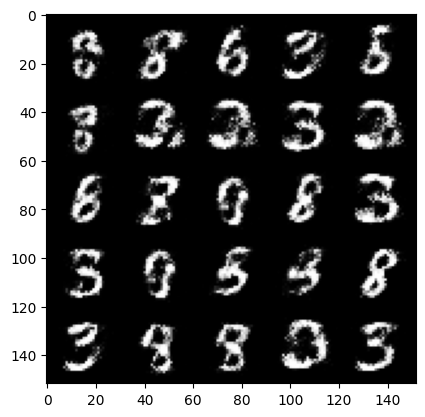

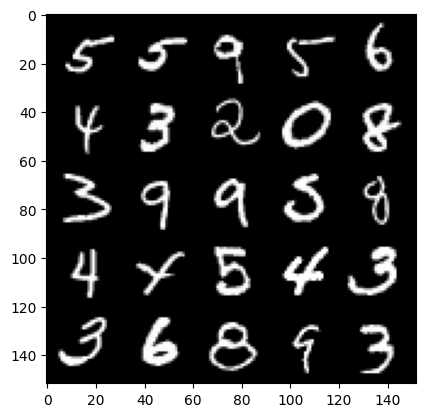

 91%|█████████▏| 429/469 [00:09<00:00, 44.58it/s]

Step 14500: Generator loss: 2.9134650125503527, discriminator loss: 0.1914333766400816


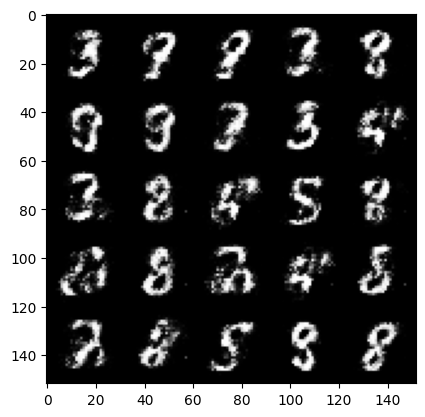

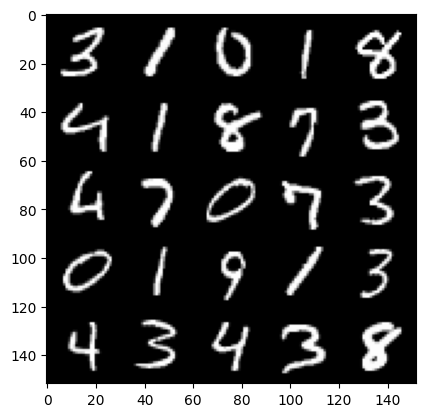

 98%|█████████▊| 460/469 [00:10<00:00, 46.66it/s]

Step 15000: Generator loss: 2.752678317070005, discriminator loss: 0.21922064000368113


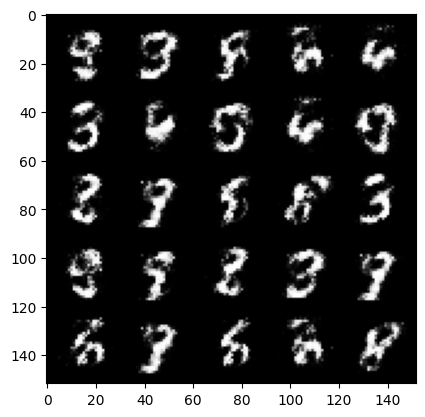

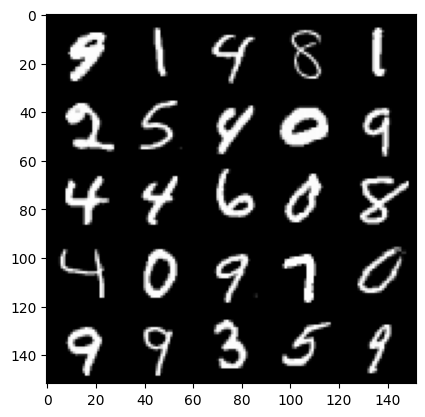

  5%|▍         | 23/469 [00:00<00:11, 40.09it/s]

Step 15500: Generator loss: 2.8053287777900695, discriminator loss: 0.2011206879317758


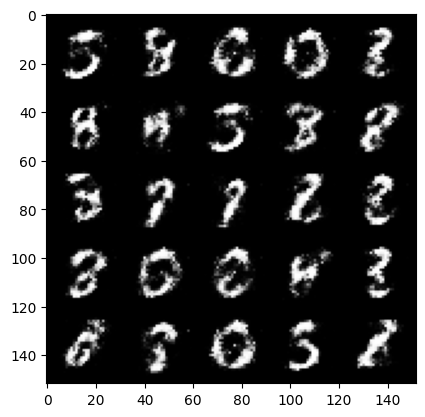

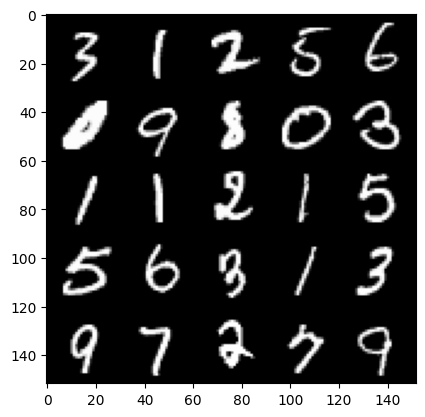

 12%|█▏        | 54/469 [00:01<00:11, 36.83it/s]

Step 16000: Generator loss: 3.0236038599014288, discriminator loss: 0.19825742825865736


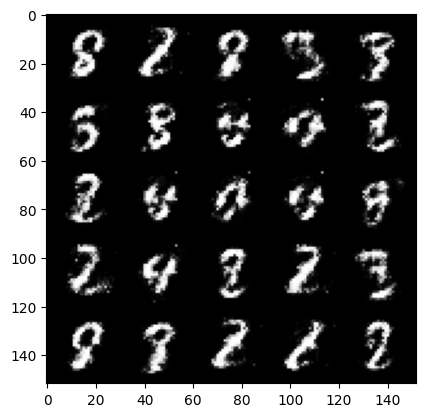

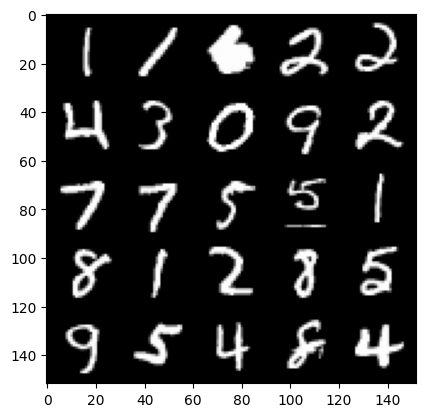

 17%|█▋        | 81/469 [00:01<00:08, 45.85it/s]

Step 16500: Generator loss: 2.9686573057174677, discriminator loss: 0.1881194943636655


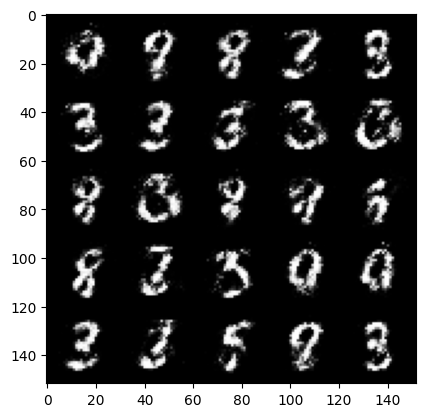

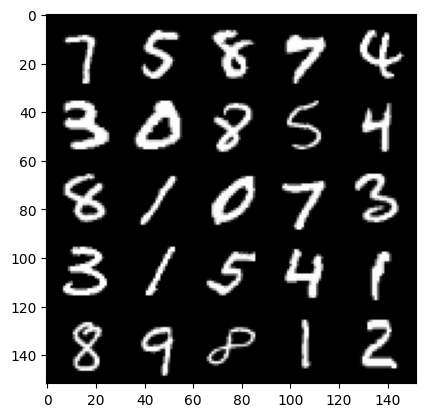

 25%|██▍       | 115/469 [00:02<00:07, 45.54it/s]

Step 17000: Generator loss: 2.6855668597221367, discriminator loss: 0.24807458713650715


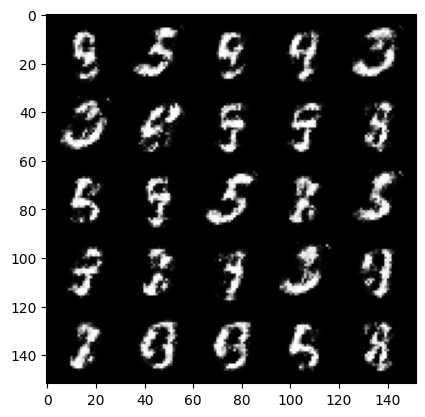

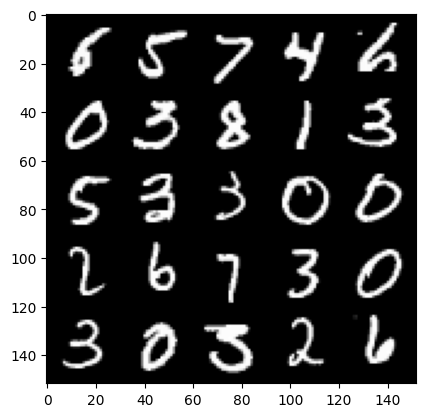

 31%|███       | 144/469 [00:03<00:06, 47.23it/s]

Step 17500: Generator loss: 2.747310384273529, discriminator loss: 0.2155043766796588


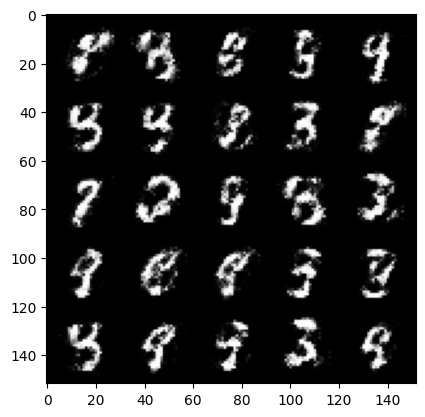

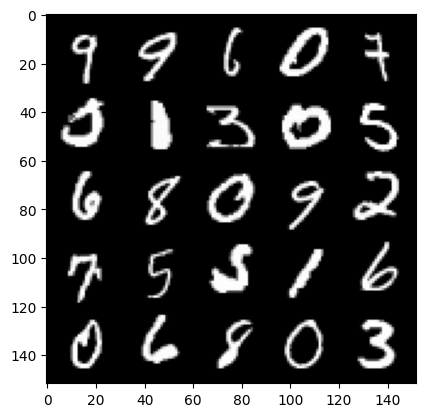

 37%|███▋      | 175/469 [00:03<00:06, 46.26it/s]

Step 18000: Generator loss: 2.812832793712616, discriminator loss: 0.2049141987264156


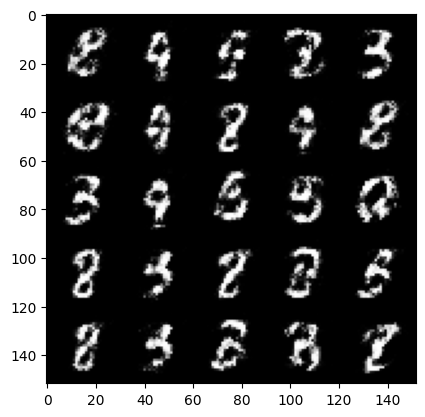

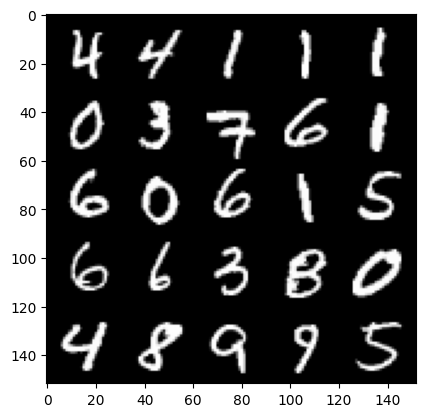

 44%|████▎     | 205/469 [00:04<00:05, 46.30it/s]

Step 18500: Generator loss: 2.830919876098634, discriminator loss: 0.20932688525319085


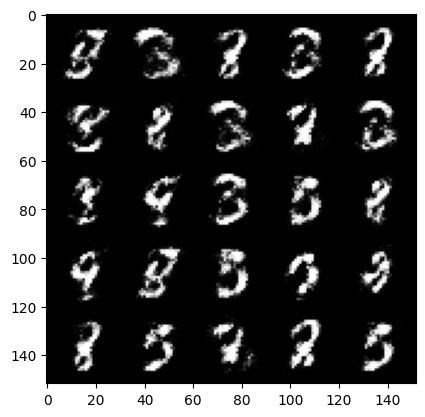

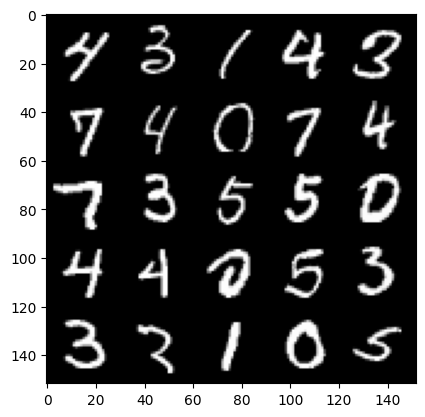

 51%|█████     | 240/469 [00:05<00:04, 46.18it/s]

Step 19000: Generator loss: 2.731046236515045, discriminator loss: 0.20900762176513674


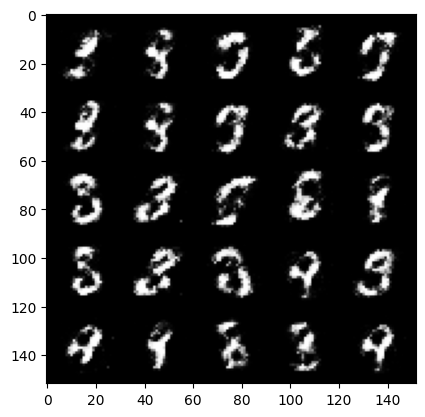

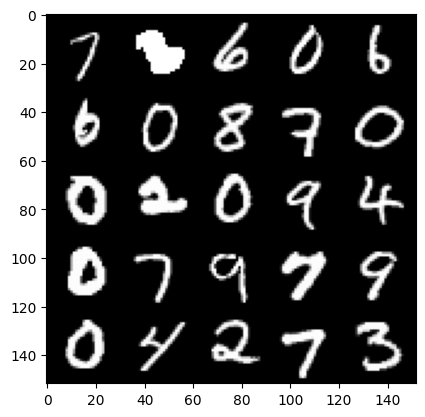

 57%|█████▋    | 269/469 [00:05<00:04, 46.40it/s]

Step 19500: Generator loss: 2.674578465938569, discriminator loss: 0.22177536642551435


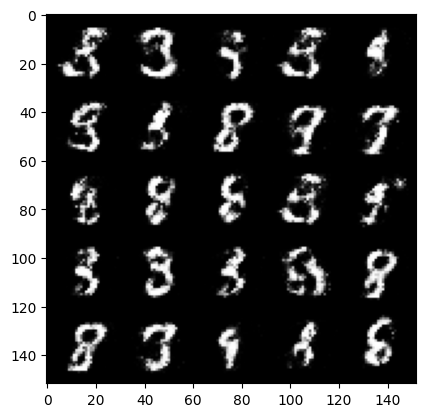

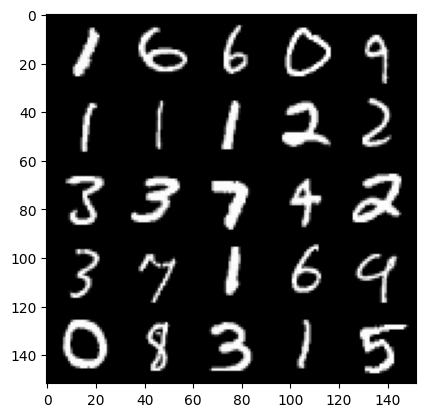

 64%|██████▍   | 300/469 [00:06<00:03, 45.33it/s]

Step 20000: Generator loss: 2.580302611827848, discriminator loss: 0.23482396677136436


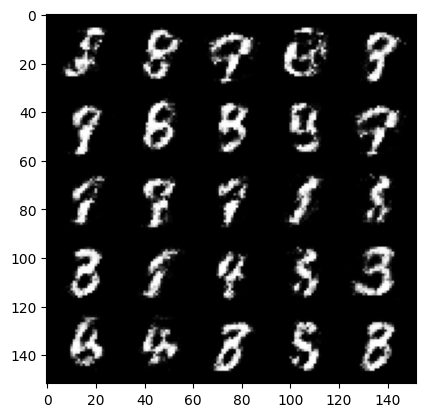

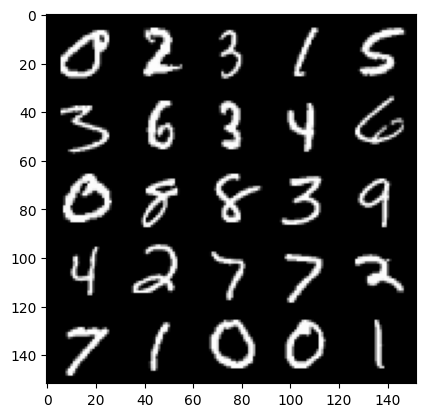

 70%|███████   | 330/469 [00:07<00:02, 46.81it/s]

Step 20500: Generator loss: 2.5190380339622522, discriminator loss: 0.23746709531545623


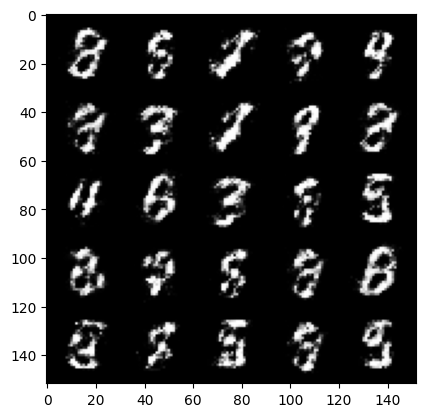

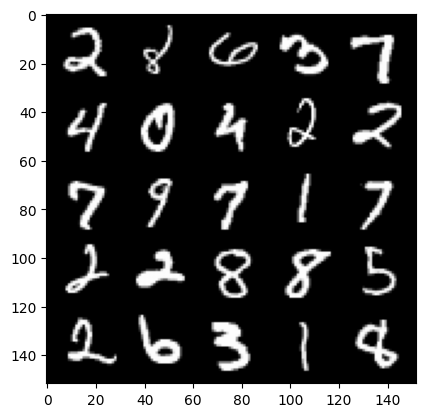

 77%|███████▋  | 360/469 [00:07<00:02, 46.72it/s]

Step 21000: Generator loss: 2.5131479752063757, discriminator loss: 0.24436678719520558


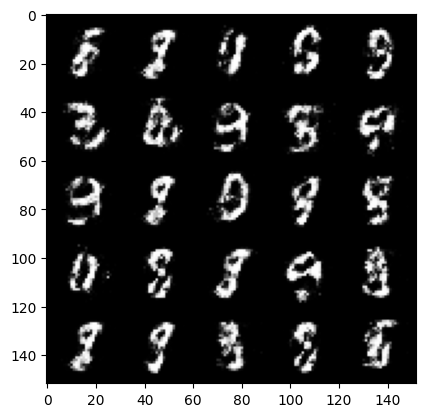

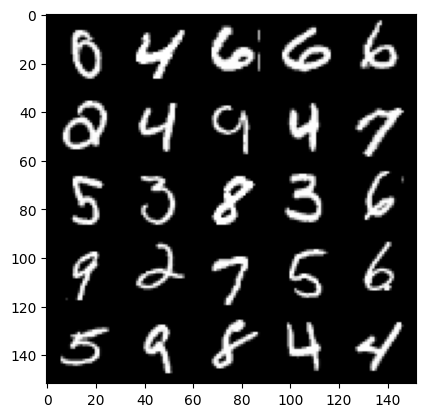

 84%|████████▍ | 395/469 [00:08<00:01, 46.97it/s]

Step 21500: Generator loss: 2.3399060795307154, discriminator loss: 0.2802466951608657


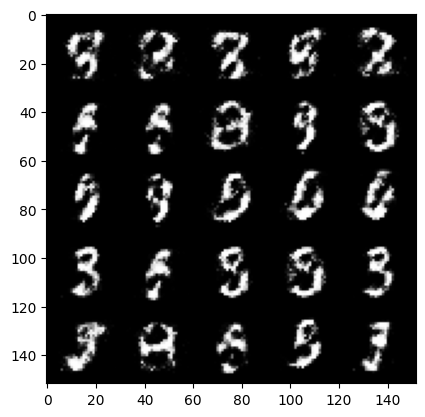

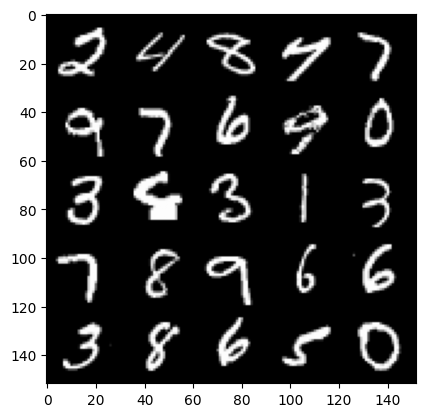

 90%|█████████ | 424/469 [00:09<00:00, 46.34it/s]

Step 22000: Generator loss: 2.483365223407743, discriminator loss: 0.2512783612012863


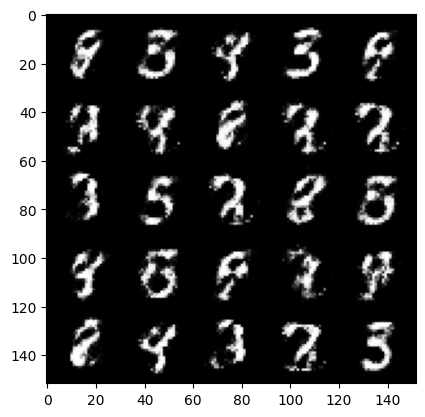

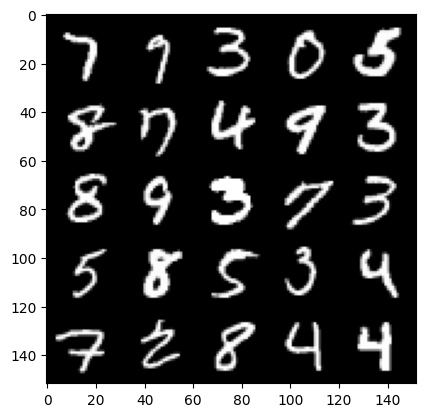

 97%|█████████▋| 454/469 [00:09<00:00, 45.84it/s]

Step 22500: Generator loss: 2.4031837313175224, discriminator loss: 0.2706728754043581


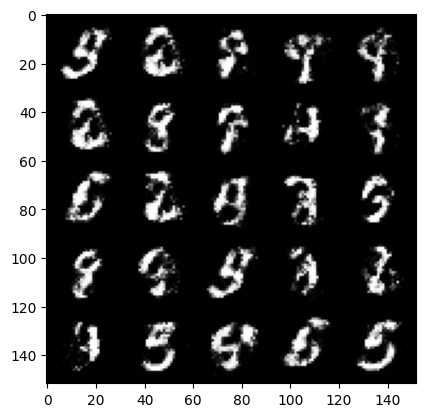

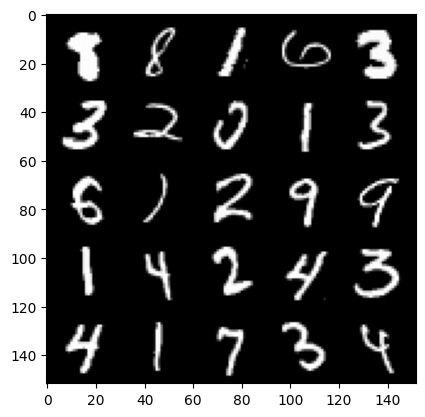

  3%|▎         | 15/469 [00:00<00:09, 45.50it/s]

Step 23000: Generator loss: 2.3948676764965042, discriminator loss: 0.2679472082257271


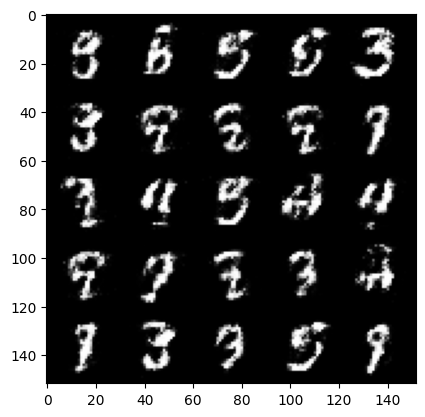

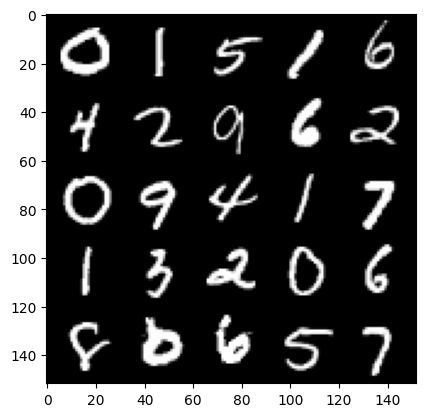

 11%|█         | 50/469 [00:01<00:09, 45.96it/s]

Step 23500: Generator loss: 2.388391027688983, discriminator loss: 0.27603895401954687


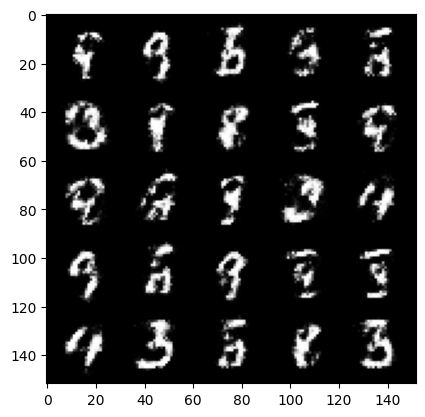

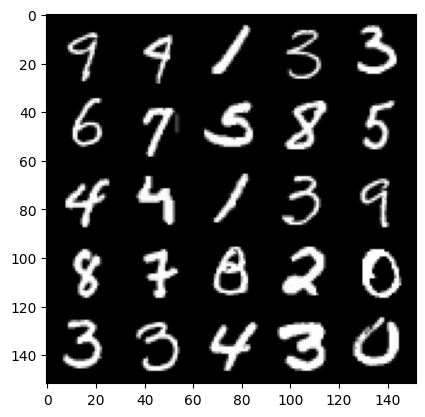

 17%|█▋        | 80/469 [00:01<00:08, 45.69it/s]

Step 24000: Generator loss: 2.3580750515460975, discriminator loss: 0.2558994137048721


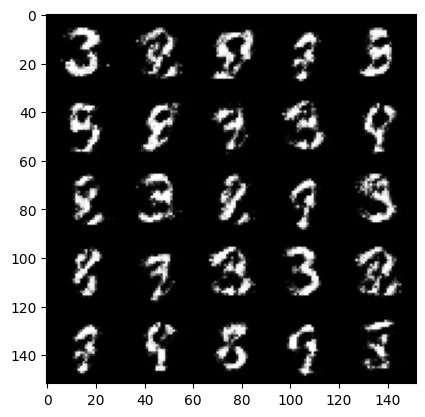

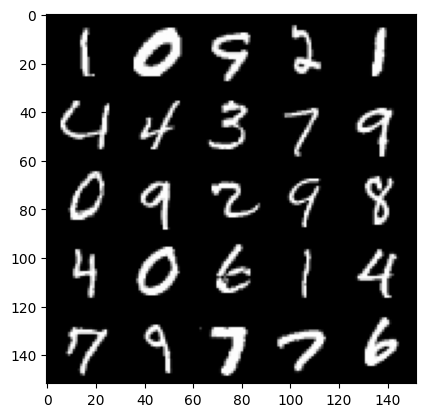

 23%|██▎       | 109/469 [00:02<00:07, 45.74it/s]

Step 24500: Generator loss: 2.342262366056443, discriminator loss: 0.2644651202559472


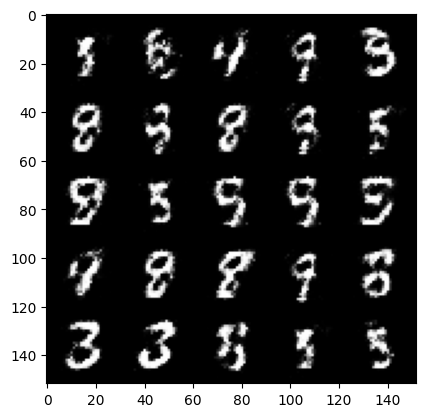

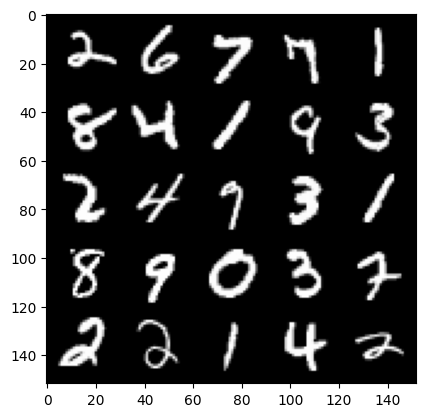

 30%|██▉       | 139/469 [00:03<00:07, 45.83it/s]

Step 25000: Generator loss: 2.3457795963287356, discriminator loss: 0.2737604268193242


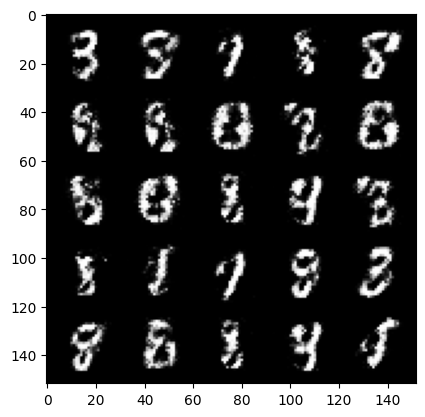

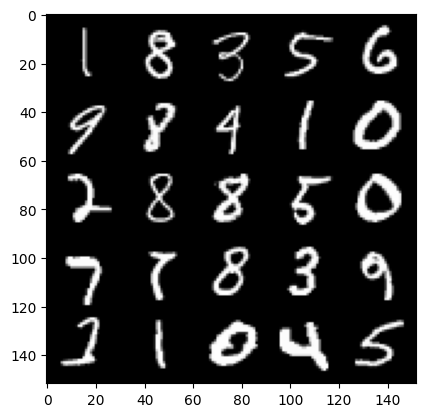

 36%|███▌      | 170/469 [00:03<00:06, 45.48it/s]

Step 25500: Generator loss: 2.2453572964668274, discriminator loss: 0.28290789800882354


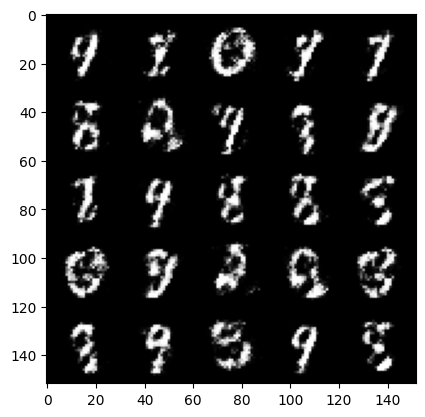

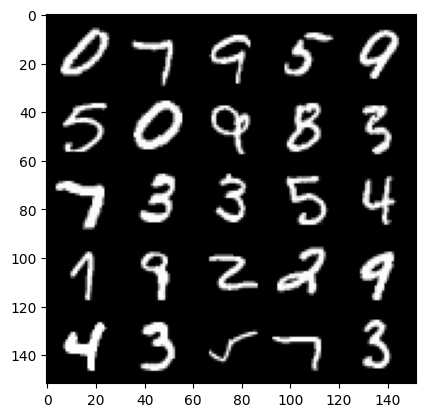

 43%|████▎     | 204/469 [00:04<00:05, 45.68it/s]

Step 26000: Generator loss: 2.364513484954834, discriminator loss: 0.2687136111557483


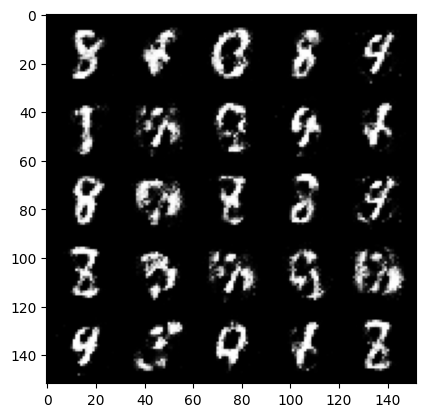

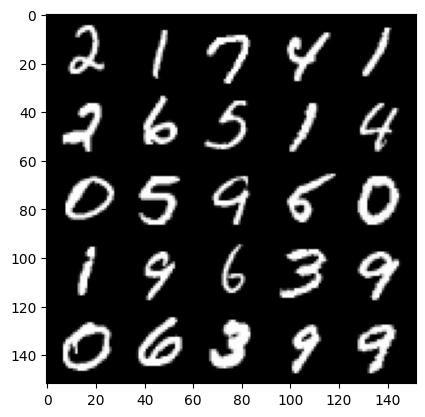

 50%|████▉     | 234/469 [00:05<00:05, 44.04it/s]

Step 26500: Generator loss: 2.1989160704612742, discriminator loss: 0.3103784462213519


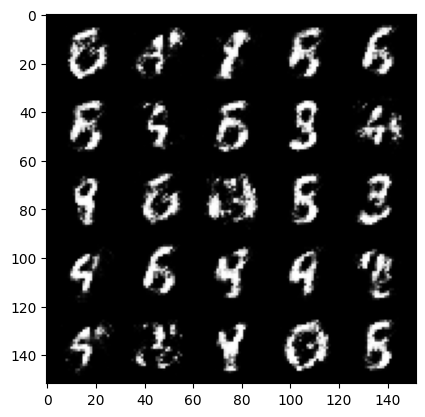

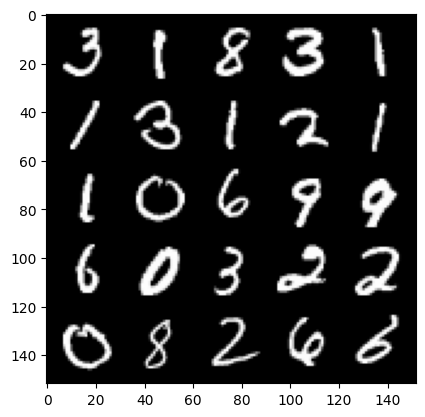

 57%|█████▋    | 265/469 [00:05<00:04, 46.14it/s]

Step 27000: Generator loss: 2.299580994844436, discriminator loss: 0.2893437687456608


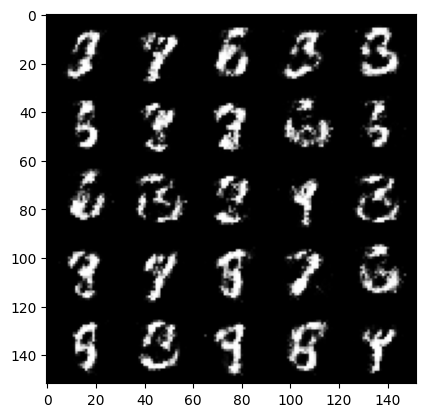

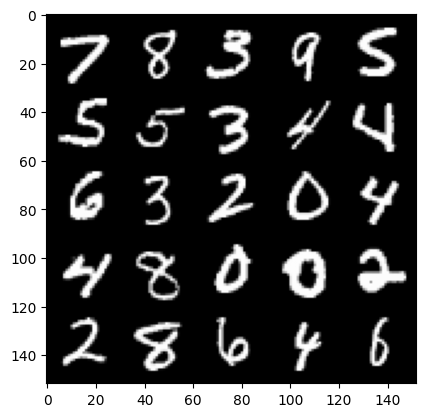

 63%|██████▎   | 294/469 [00:06<00:03, 44.21it/s]

Step 27500: Generator loss: 2.2441516437530518, discriminator loss: 0.2890965080261229


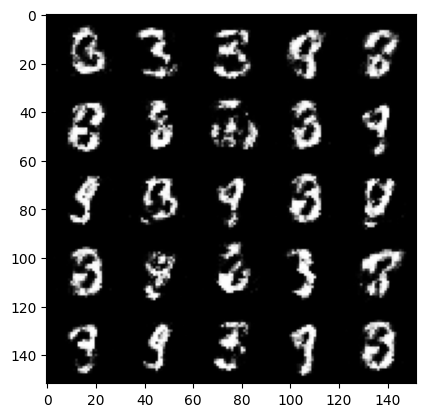

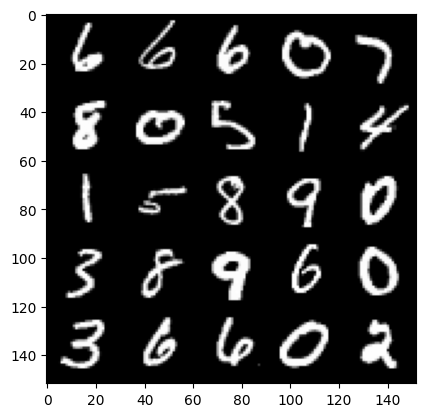

 70%|███████   | 329/469 [00:07<00:03, 45.70it/s]

Step 28000: Generator loss: 2.198882501363754, discriminator loss: 0.30195178574323633


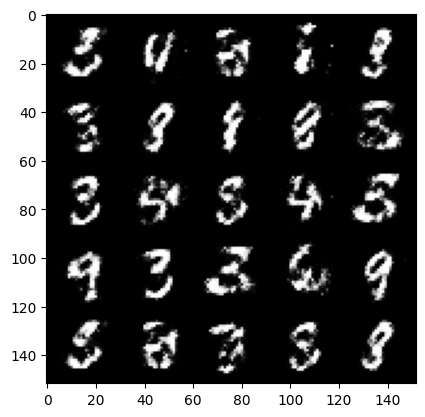

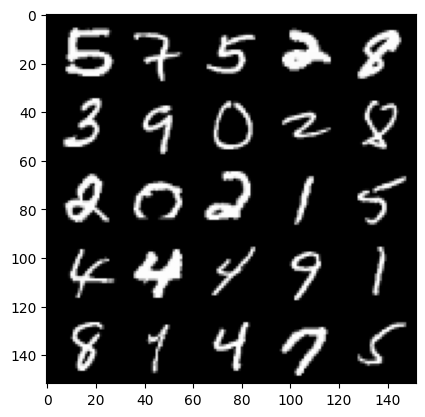

 77%|███████▋  | 359/469 [00:08<00:02, 45.20it/s]

Step 28500: Generator loss: 2.1259253802299503, discriminator loss: 0.3152100786566734


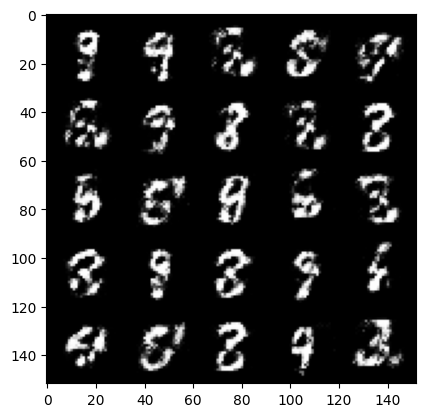

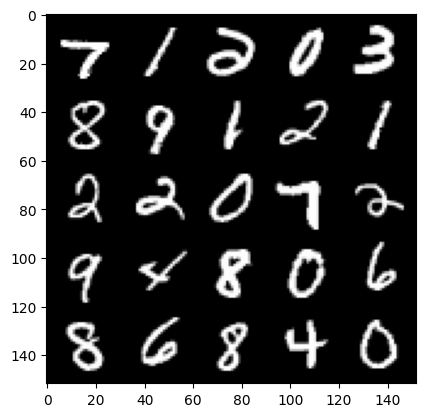

 83%|████████▎ | 389/469 [00:08<00:01, 46.41it/s]

Step 29000: Generator loss: 2.1132245001792915, discriminator loss: 0.30150047057867013


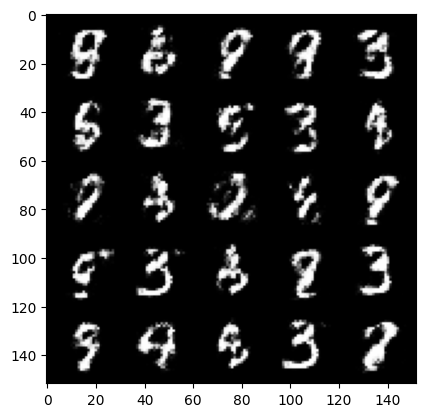

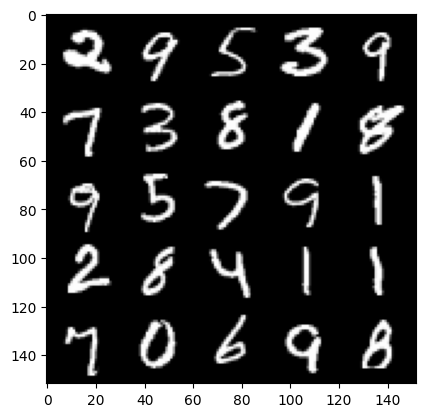

 90%|████████▉ | 420/469 [00:09<00:01, 44.31it/s]

Step 29500: Generator loss: 2.2211801154613493, discriminator loss: 0.2928490429818631


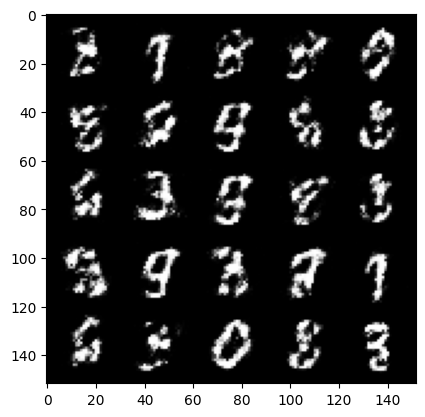

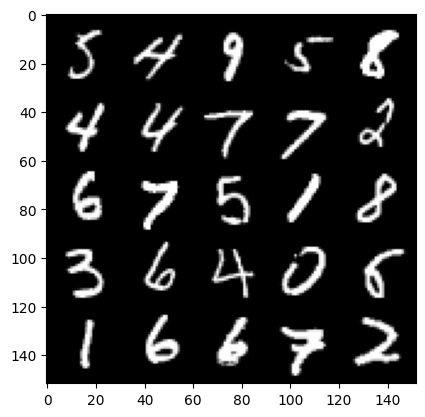

 96%|█████████▋| 452/469 [00:10<00:00, 48.42it/s]

Step 30000: Generator loss: 2.0892823712825783, discriminator loss: 0.32686439618468255


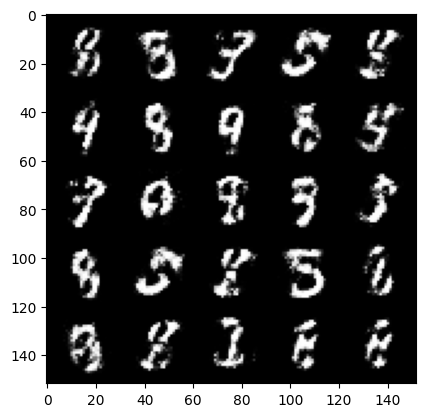

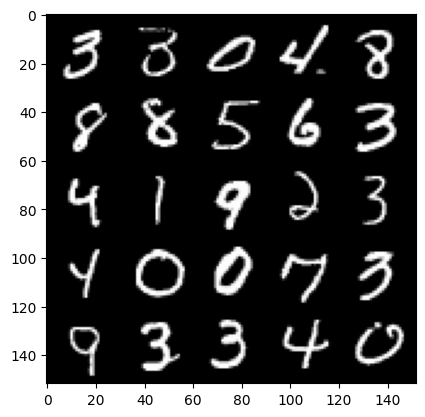

  3%|▎         | 15/469 [00:00<00:10, 44.40it/s]

Step 30500: Generator loss: 2.2656370038986187, discriminator loss: 0.26801500546932233


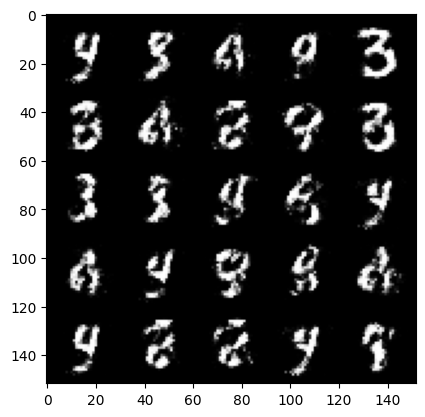

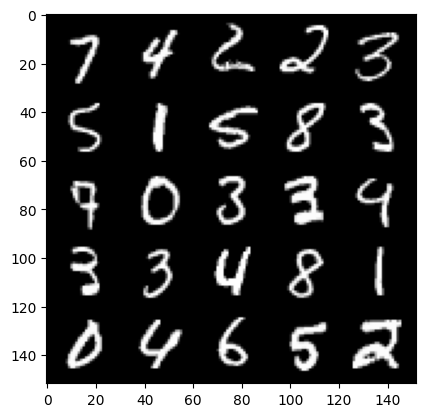

 10%|▉         | 45/469 [00:00<00:09, 45.42it/s]

Step 31000: Generator loss: 2.1972915084362024, discriminator loss: 0.29069171383976944


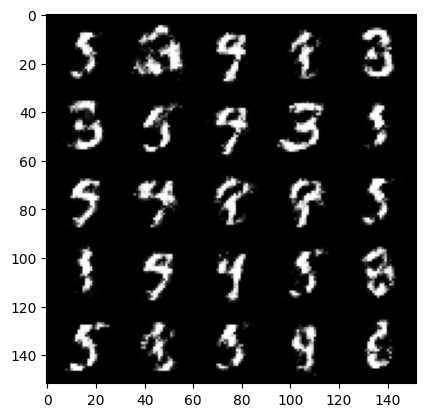

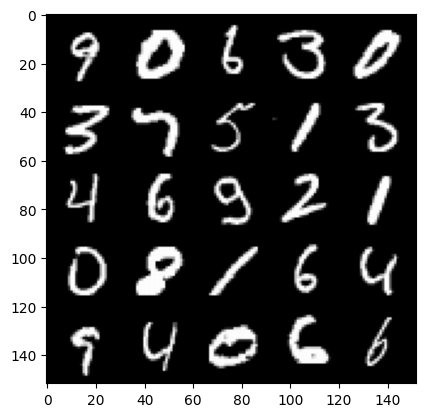

 16%|█▌        | 75/469 [00:01<00:08, 45.62it/s]

Step 31500: Generator loss: 2.234413451671597, discriminator loss: 0.2811233760416508


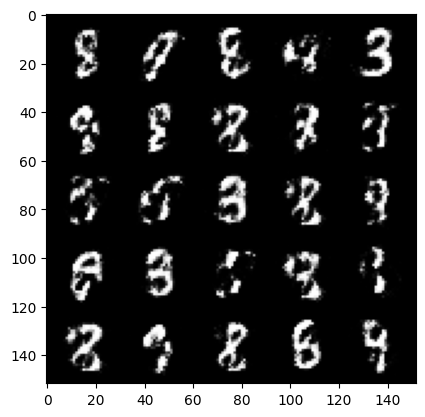

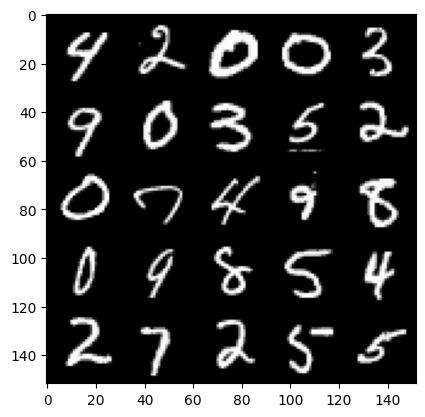

 22%|██▏       | 105/469 [00:02<00:07, 46.11it/s]

Step 32000: Generator loss: 2.170948133707045, discriminator loss: 0.310822899401188


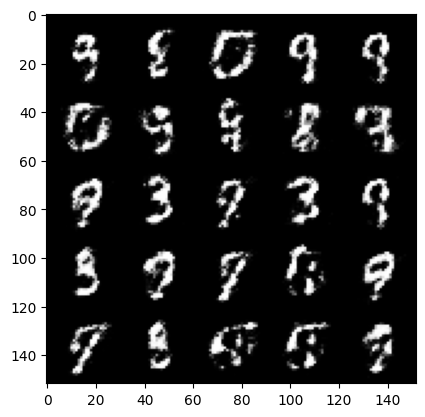

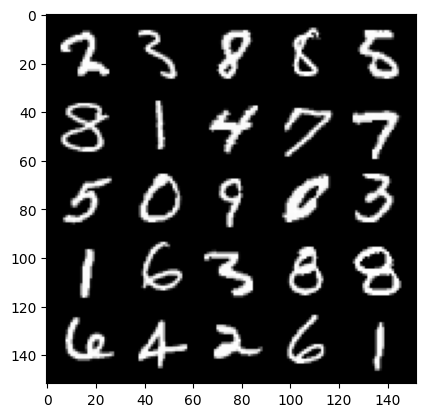

 29%|██▉       | 135/469 [00:02<00:07, 45.99it/s]

Step 32500: Generator loss: 2.1249282381534553, discriminator loss: 0.2966776415109635


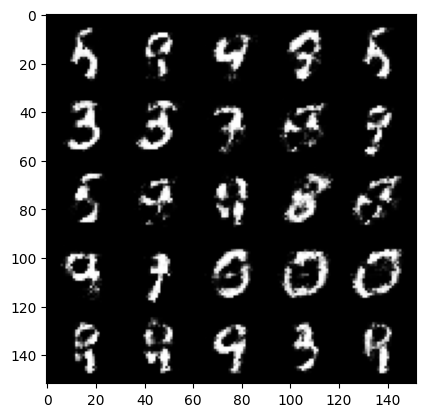

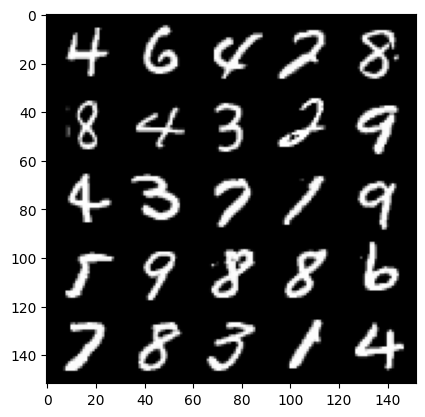

 36%|███▌      | 170/469 [00:03<00:06, 45.17it/s]

Step 33000: Generator loss: 2.0081527547836306, discriminator loss: 0.33027531713247366


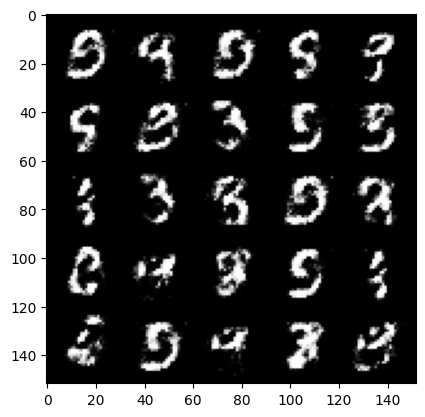

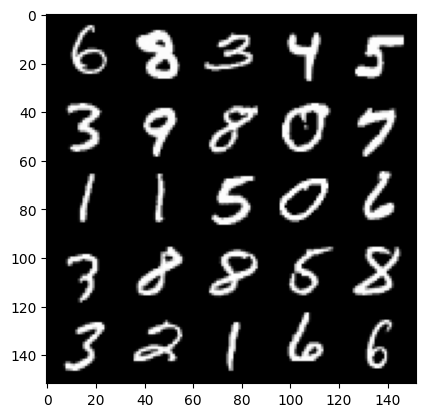

 43%|████▎     | 201/469 [00:04<00:06, 42.26it/s]

Step 33500: Generator loss: 2.1654089159965513, discriminator loss: 0.2890005387365816


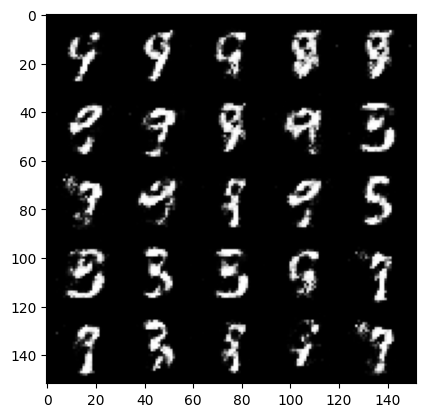

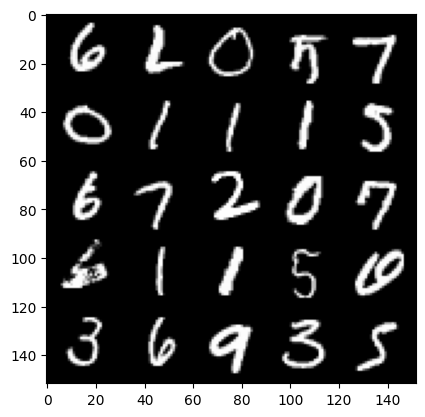

 49%|████▉     | 230/469 [00:05<00:05, 41.76it/s]

Step 34000: Generator loss: 2.0777300405502324, discriminator loss: 0.3312196225821973


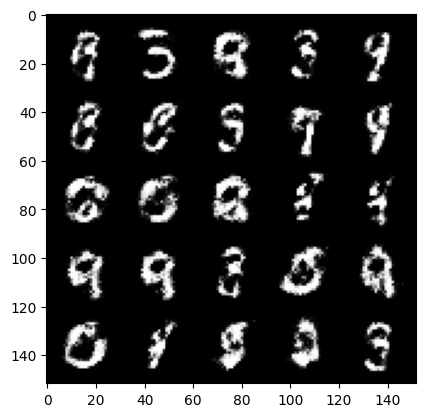

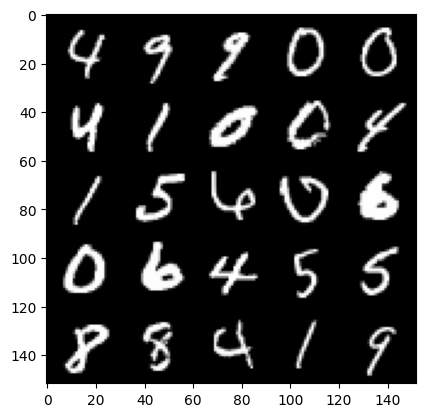

 55%|█████▌    | 260/469 [00:05<00:04, 46.26it/s]

Step 34500: Generator loss: 2.014634710788727, discriminator loss: 0.3434003992378712


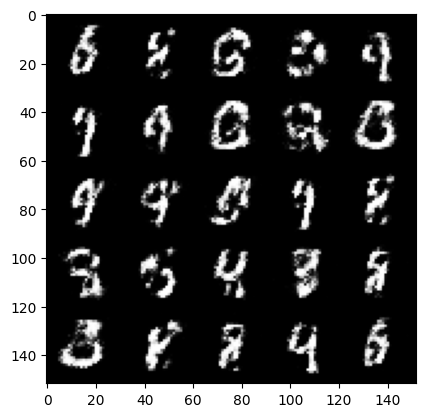

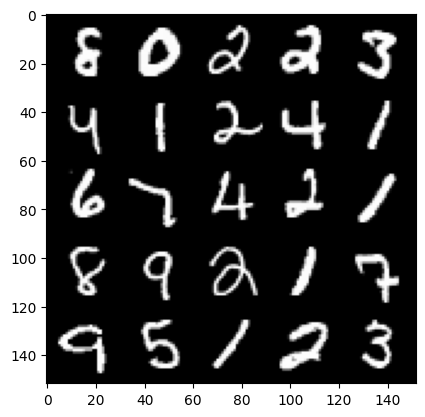

 62%|██████▏   | 290/469 [00:06<00:03, 45.85it/s]

Step 35000: Generator loss: 1.8657405362129214, discriminator loss: 0.3740478494167329


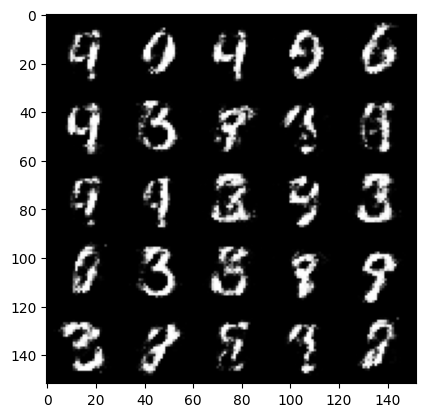

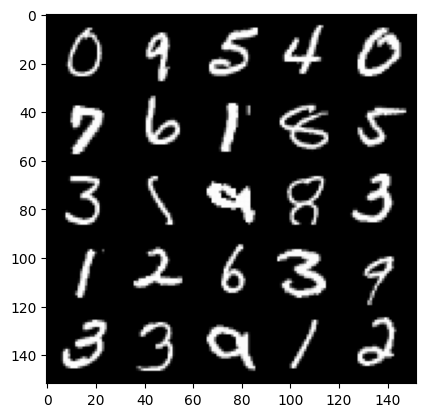

 69%|██████▉   | 325/469 [00:07<00:03, 46.43it/s]

Step 35500: Generator loss: 1.848700120687482, discriminator loss: 0.3726133845448491


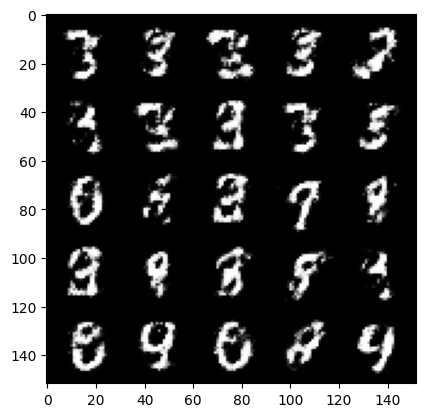

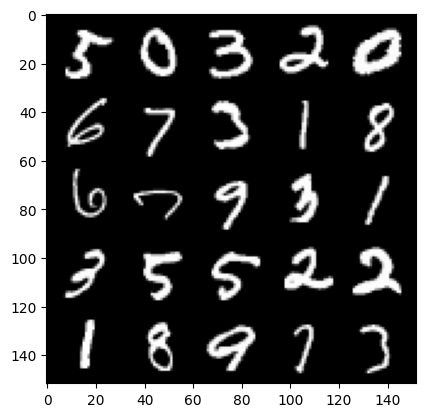

 76%|███████▌  | 355/469 [00:07<00:02, 46.30it/s]

Step 36000: Generator loss: 1.859766273260116, discriminator loss: 0.35785203385353104


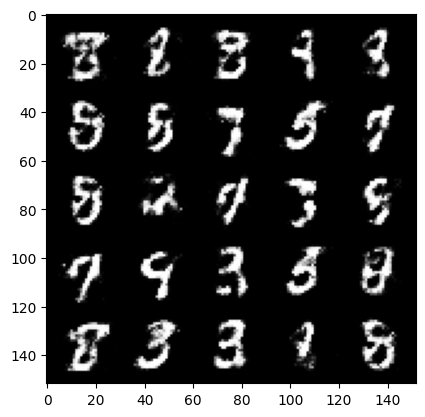

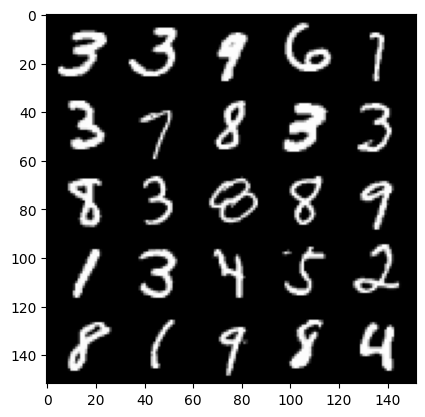

 82%|████████▏ | 383/469 [00:08<00:02, 42.91it/s]

Step 36500: Generator loss: 1.917493406057357, discriminator loss: 0.3376334625780582


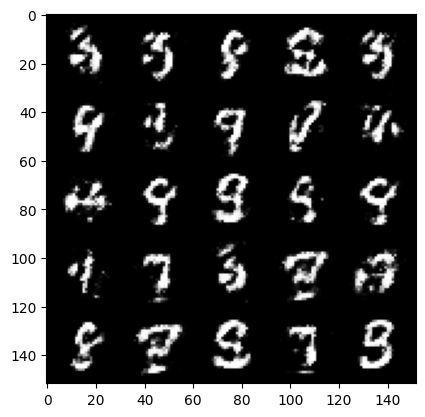

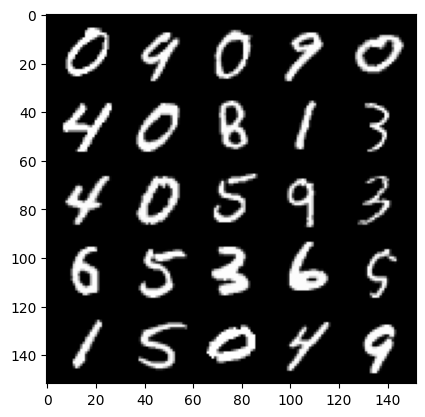

 88%|████████▊ | 414/469 [00:09<00:01, 46.47it/s]

Step 37000: Generator loss: 1.9745674822330477, discriminator loss: 0.3270867804586888


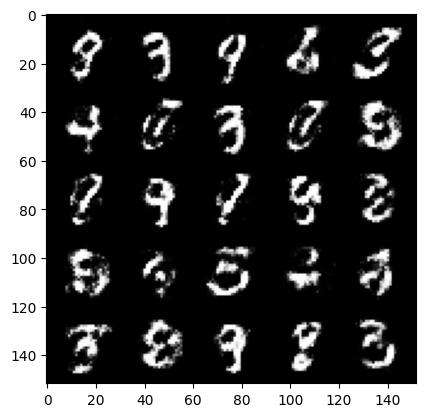

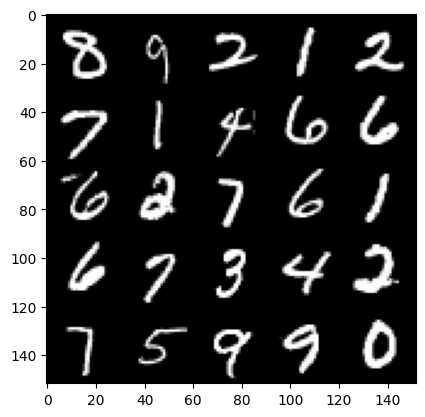

 95%|█████████▍| 445/469 [00:09<00:00, 44.30it/s]

Step 37500: Generator loss: 1.9280765588283546, discriminator loss: 0.3473375905752181


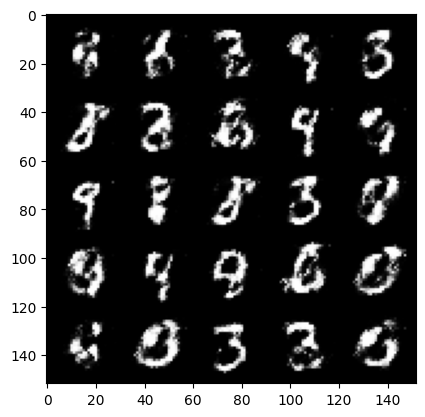

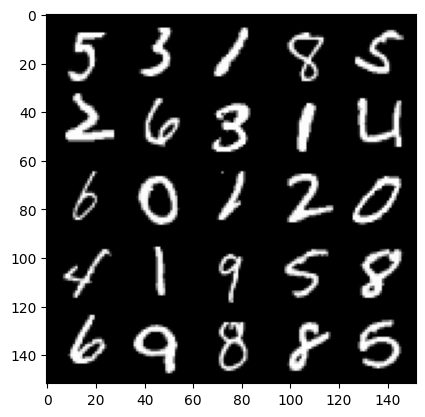

  2%|▏         | 10/469 [00:00<00:10, 44.43it/s]

Step 38000: Generator loss: 1.8586120090484617, discriminator loss: 0.3671760146617888


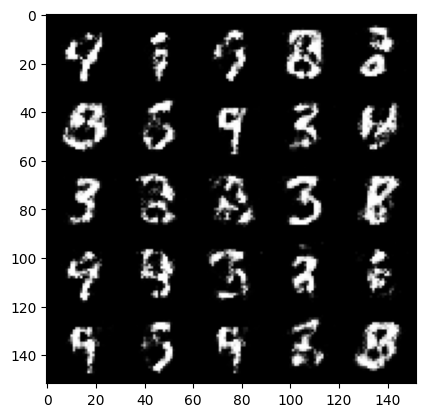

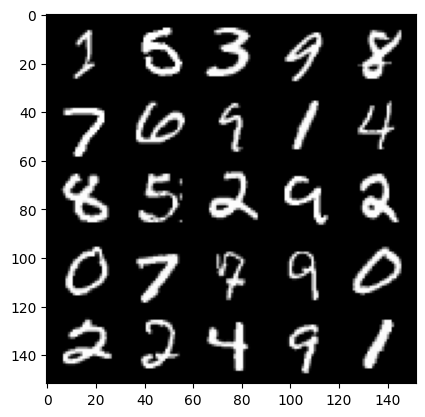

  9%|▊         | 40/469 [00:00<00:09, 46.45it/s]

Step 38500: Generator loss: 1.875162504673006, discriminator loss: 0.3529102883934974


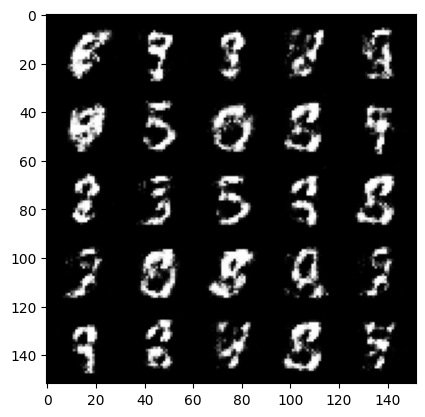

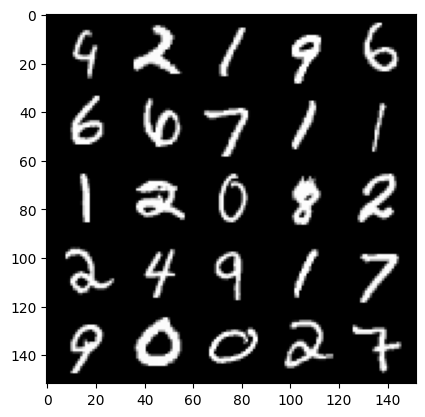

 15%|█▍        | 70/469 [00:01<00:08, 44.90it/s]

Step 39000: Generator loss: 1.8850777759552002, discriminator loss: 0.35570007267594334


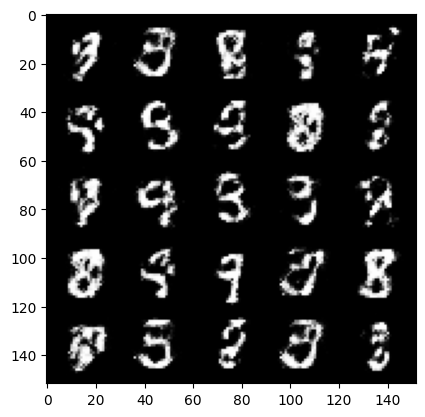

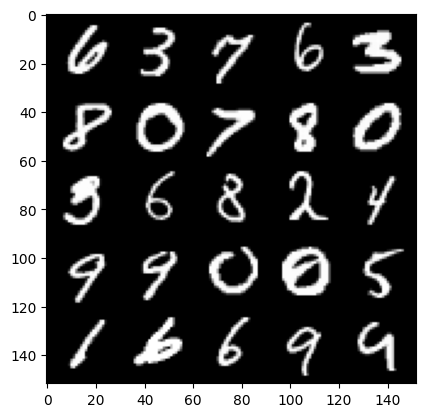

 21%|██▏       | 100/469 [00:02<00:07, 46.72it/s]

Step 39500: Generator loss: 1.871091839790346, discriminator loss: 0.35739239218831037


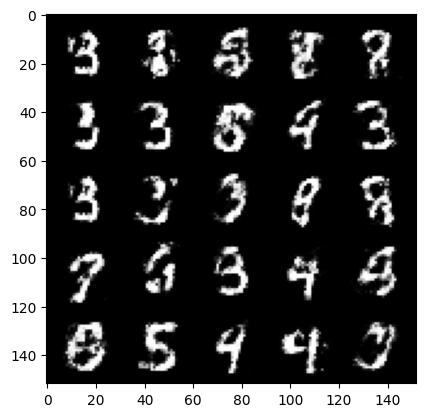

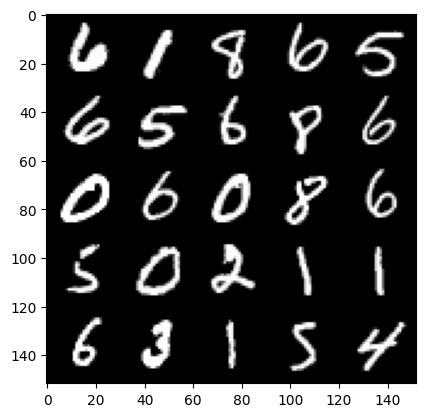

 29%|██▉       | 135/469 [00:02<00:07, 46.85it/s]

Step 40000: Generator loss: 1.8688973891735081, discriminator loss: 0.350685634613037


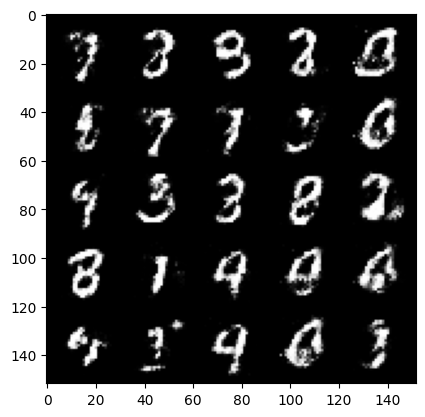

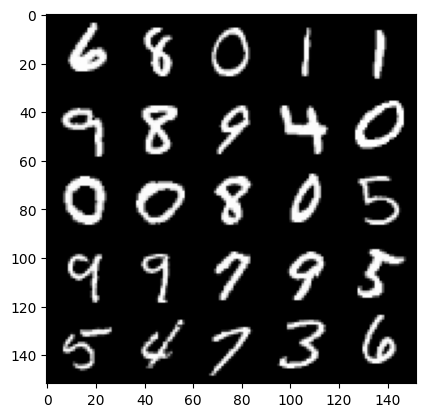

 35%|███▍      | 164/469 [00:03<00:06, 46.35it/s]

Step 40500: Generator loss: 1.7959434776306156, discriminator loss: 0.3721389637589454


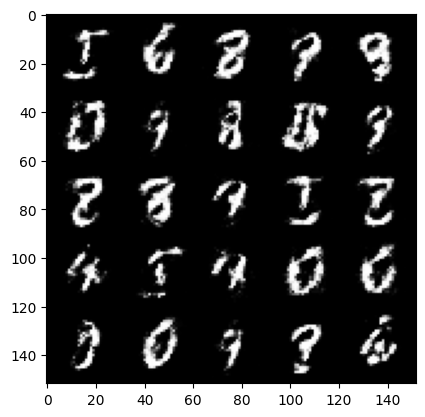

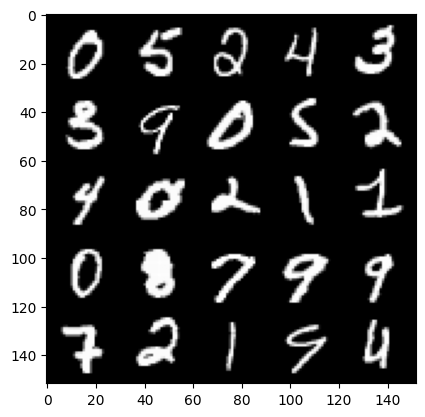

 42%|████▏     | 195/469 [00:04<00:05, 46.69it/s]

Step 41000: Generator loss: 1.7820629937648775, discriminator loss: 0.35918913918733625


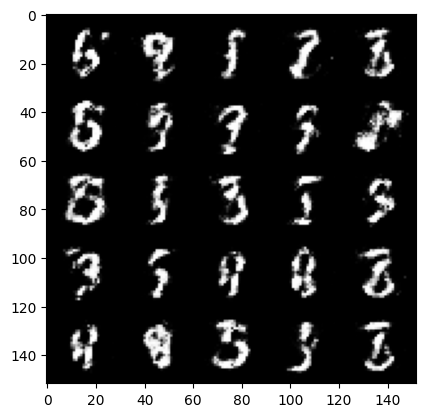

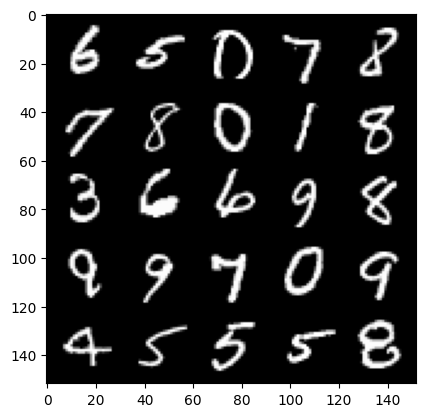

 49%|████▊     | 228/469 [00:04<00:05, 47.12it/s]

Step 41500: Generator loss: 1.7721741895675653, discriminator loss: 0.37332617563009246


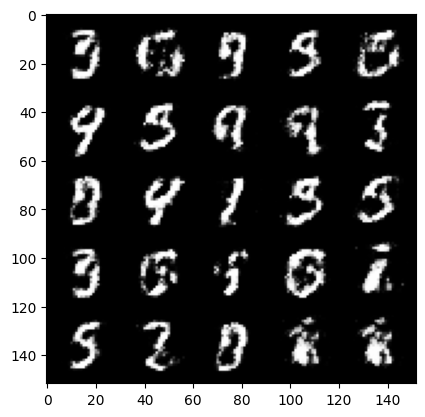

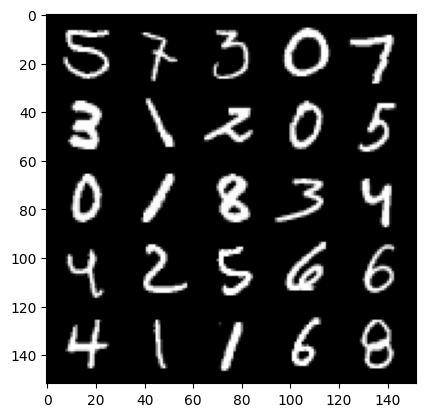

 54%|█████▍    | 255/469 [00:05<00:04, 45.38it/s]

Step 42000: Generator loss: 1.7290922734737393, discriminator loss: 0.38132013434171674


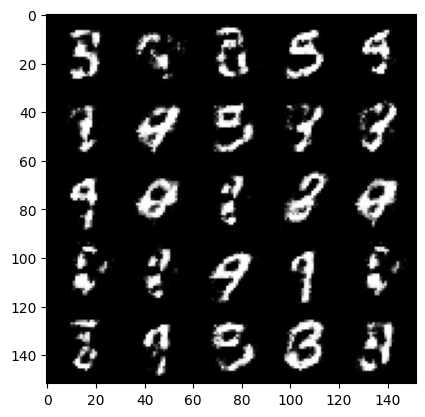

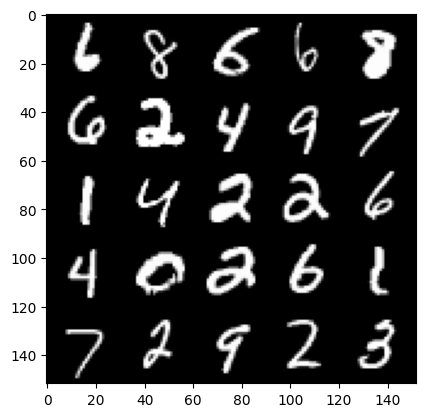

 62%|██████▏   | 290/469 [00:06<00:03, 46.36it/s]

Step 42500: Generator loss: 1.743889614105225, discriminator loss: 0.3861771239638329


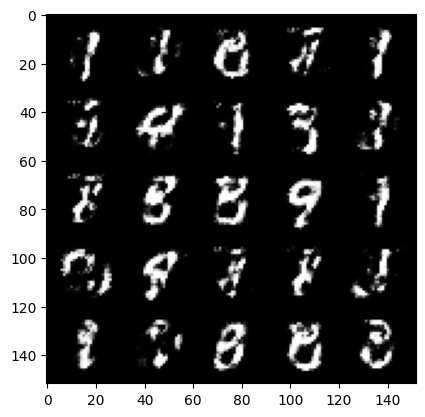

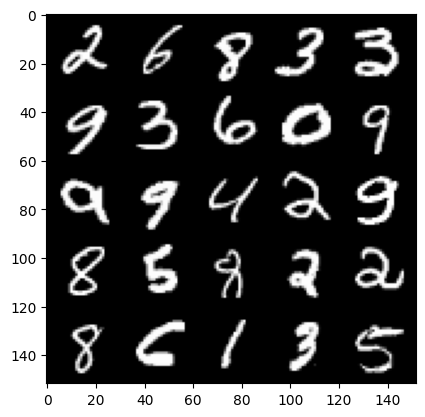

 68%|██████▊   | 320/469 [00:06<00:03, 44.99it/s]

Step 43000: Generator loss: 1.6884324557781245, discriminator loss: 0.39422609144449255


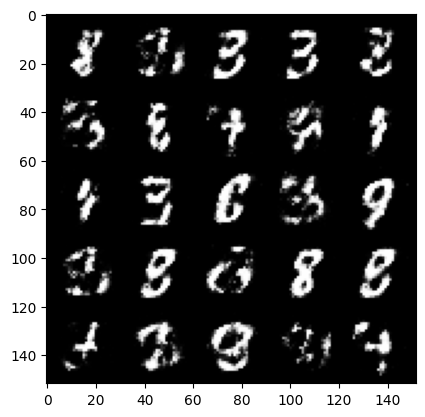

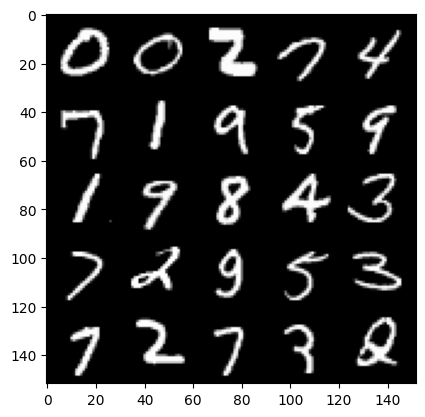

 75%|███████▍  | 350/469 [00:07<00:02, 46.17it/s]

Step 43500: Generator loss: 1.662569732427598, discriminator loss: 0.3951834761500358


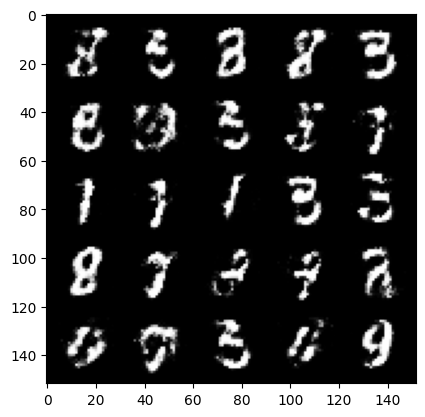

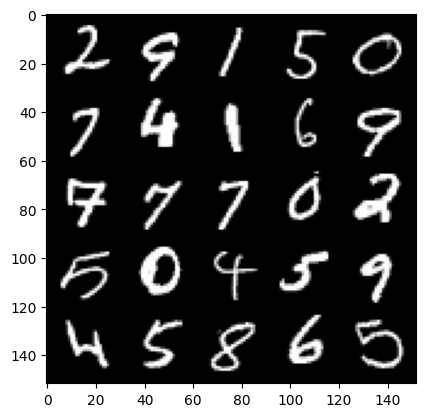

 81%|████████  | 380/469 [00:08<00:01, 46.45it/s]

Step 44000: Generator loss: 1.71353560400009, discriminator loss: 0.3790431922674183


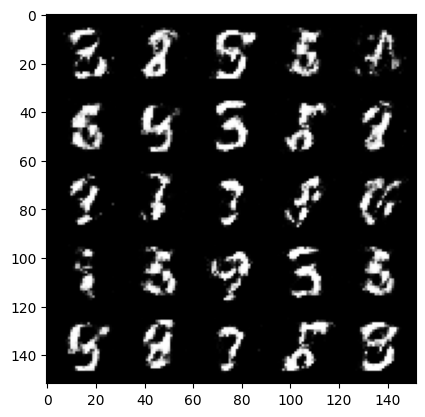

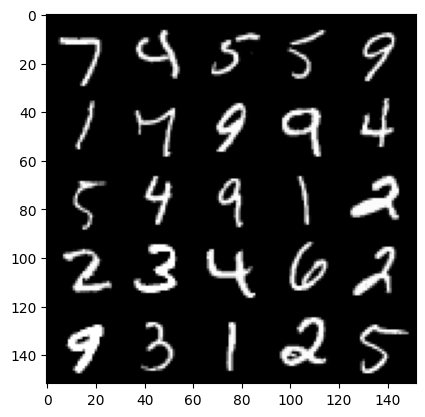

 87%|████████▋ | 410/469 [00:08<00:01, 46.75it/s]

Step 44500: Generator loss: 1.5923777132034311, discriminator loss: 0.4208244789838794


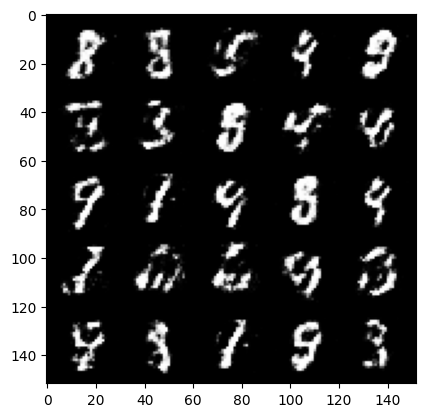

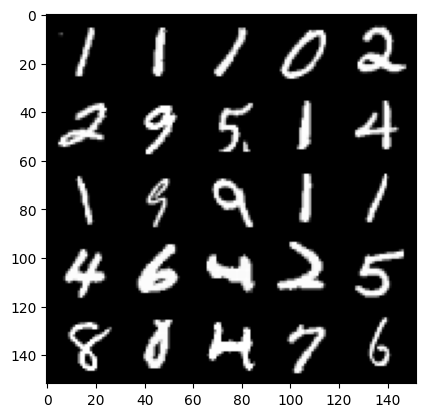

 95%|█████████▍| 445/469 [00:09<00:00, 45.65it/s]

Step 45000: Generator loss: 1.5875428910255434, discriminator loss: 0.4263025324344633


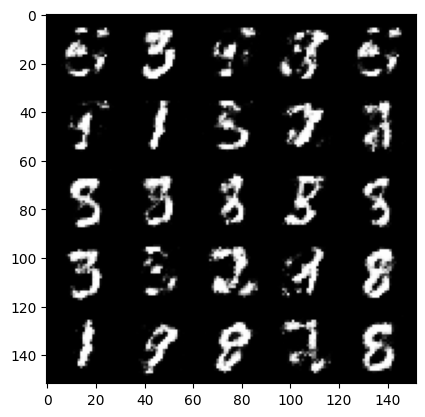

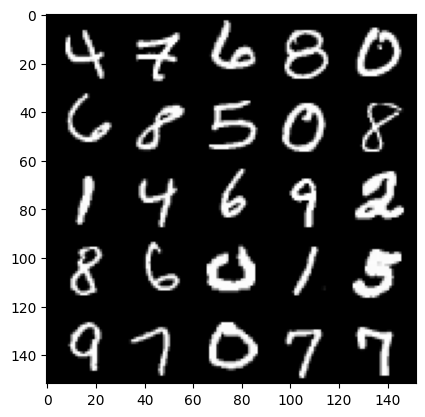

  1%|          | 5/469 [00:00<00:10, 43.16it/s]

Step 45500: Generator loss: 1.5988245062828084, discriminator loss: 0.420433497309685


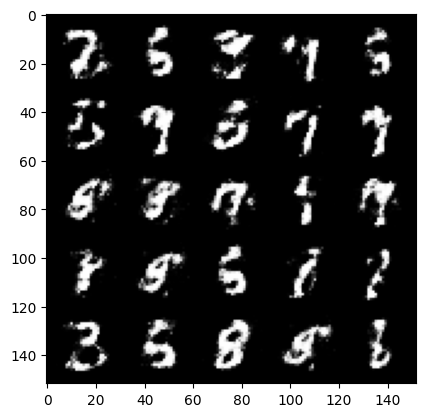

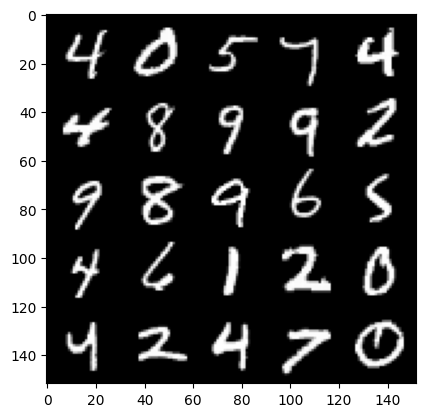

  7%|▋         | 35/469 [00:00<00:09, 46.74it/s]

Step 46000: Generator loss: 1.7094855165481586, discriminator loss: 0.37722530508041396


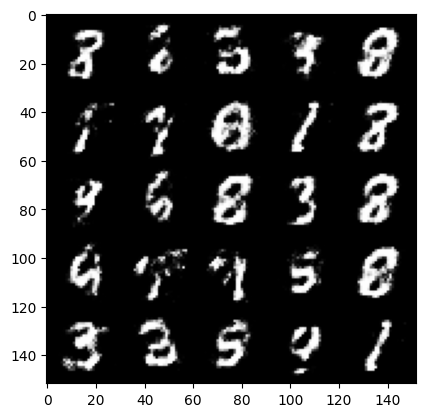

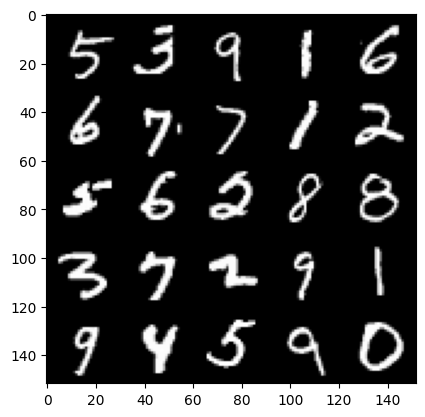

 14%|█▍        | 65/469 [00:01<00:08, 45.82it/s]

Step 46500: Generator loss: 1.5956669807434076, discriminator loss: 0.416299804627895


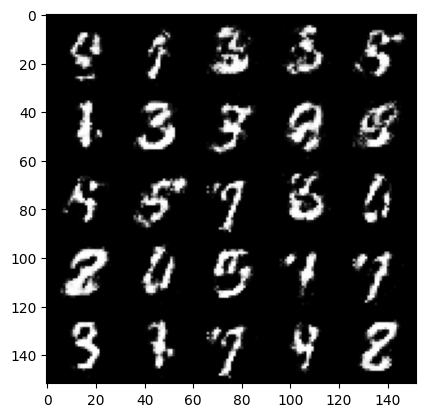

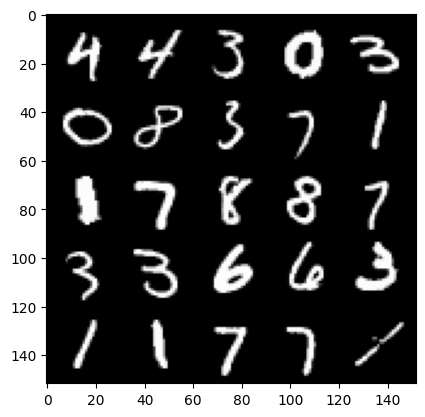

 21%|██▏       | 100/469 [00:02<00:07, 46.77it/s]

Step 47000: Generator loss: 1.6221589038372035, discriminator loss: 0.3964621486067772


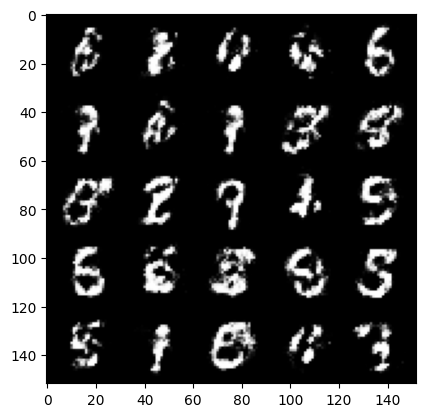

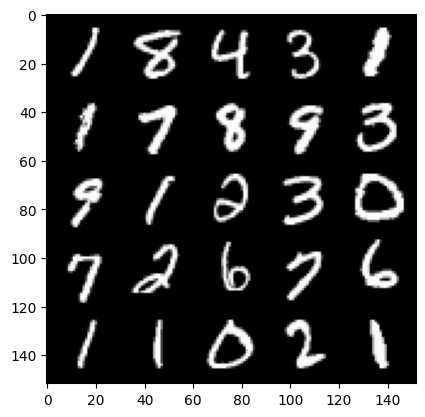

 28%|██▊       | 129/469 [00:02<00:07, 45.86it/s]

Step 47500: Generator loss: 1.7179672400951378, discriminator loss: 0.37874633854627626


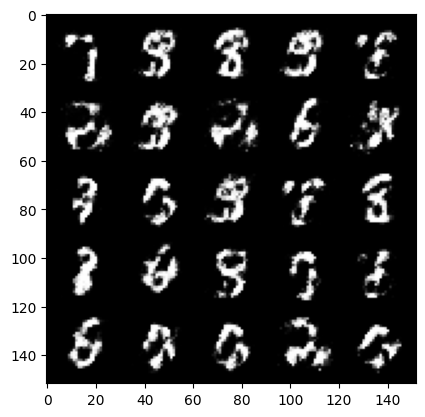

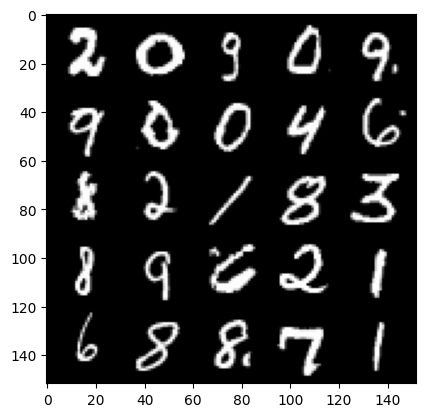

 34%|███▍      | 159/469 [00:03<00:06, 46.06it/s]

Step 48000: Generator loss: 1.658368616819382, discriminator loss: 0.397085510134697


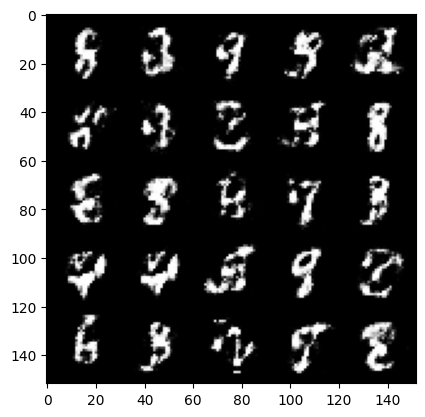

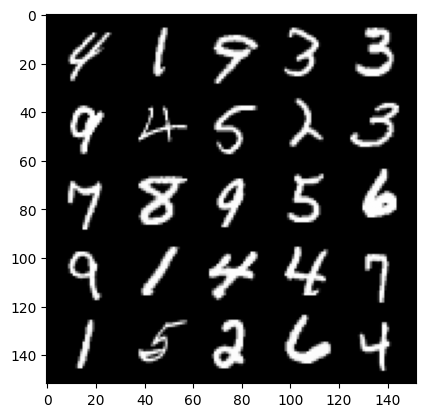

 40%|████      | 189/469 [00:04<00:06, 45.29it/s]

Step 48500: Generator loss: 1.64813377857208, discriminator loss: 0.39830701851844774


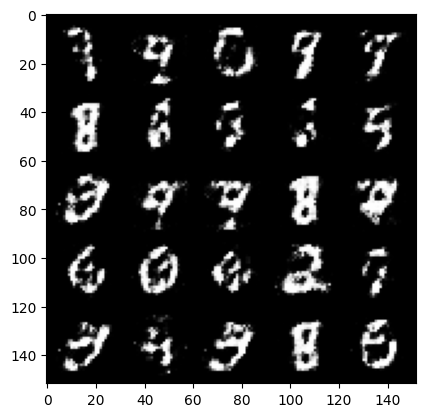

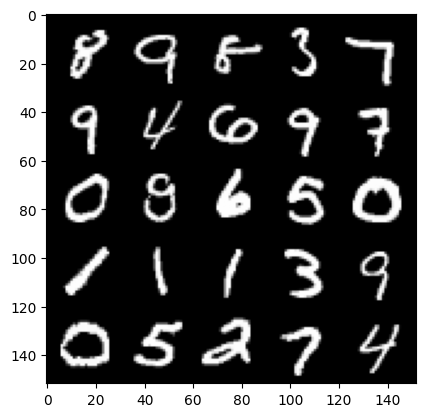

 47%|████▋     | 220/469 [00:04<00:05, 46.56it/s]

Step 49000: Generator loss: 1.6121025516986847, discriminator loss: 0.40866270750761047


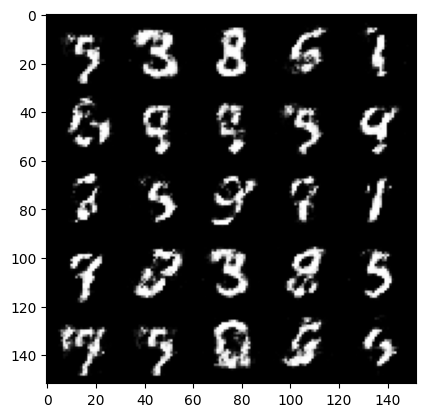

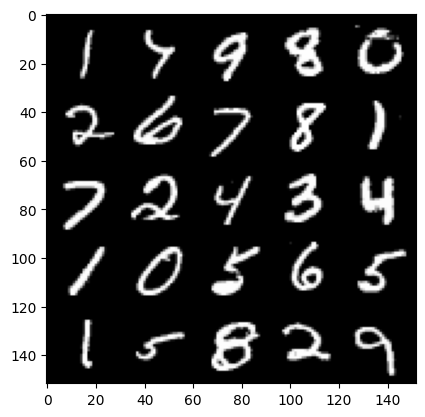

 54%|█████▍    | 255/469 [00:05<00:04, 45.87it/s]

Step 49500: Generator loss: 1.6472217609882354, discriminator loss: 0.38732379299402253


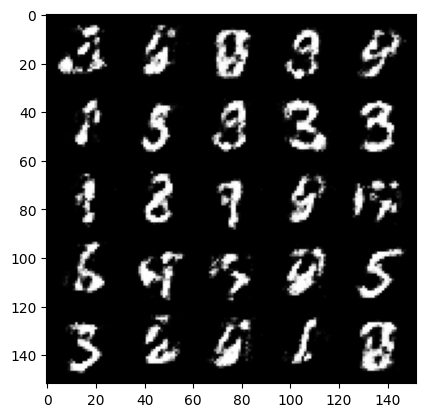

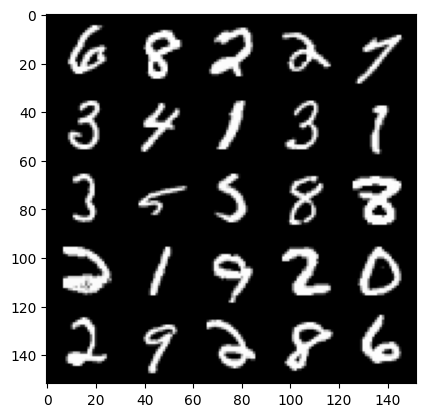

 61%|██████    | 285/469 [00:06<00:04, 44.79it/s]

Step 50000: Generator loss: 1.7122281062602993, discriminator loss: 0.3808256529569623


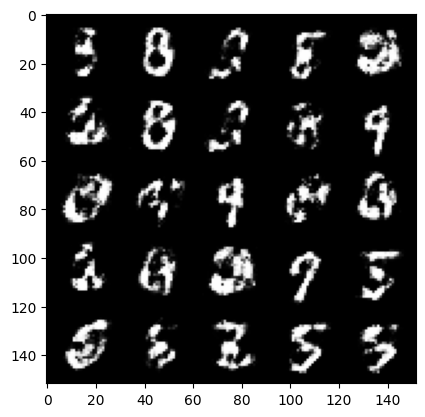

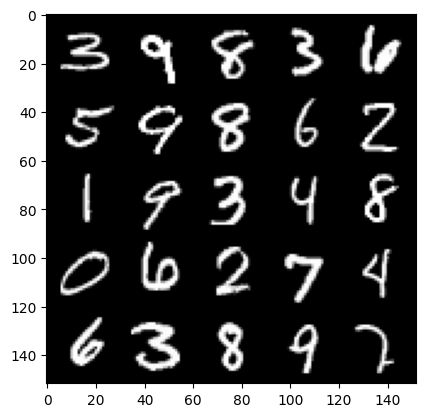

 67%|██████▋   | 315/469 [00:06<00:03, 42.89it/s]

Step 50500: Generator loss: 1.6089327018260973, discriminator loss: 0.40313016837835314


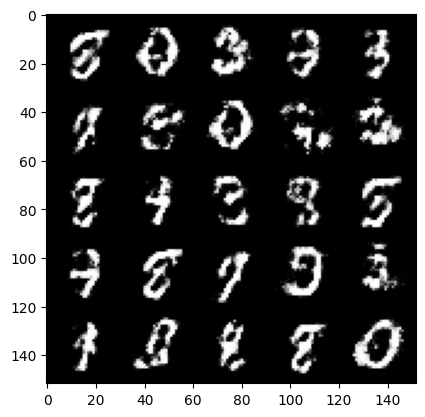

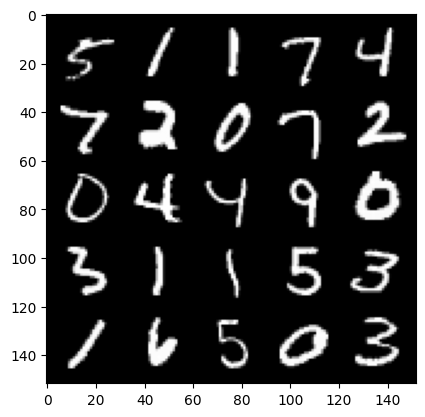

 74%|███████▎  | 345/469 [00:07<00:02, 46.26it/s]

Step 51000: Generator loss: 1.702708671331405, discriminator loss: 0.38902931559085846


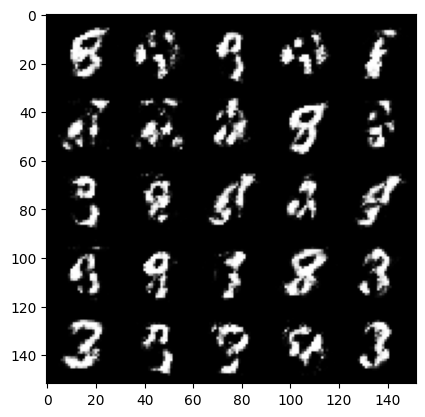

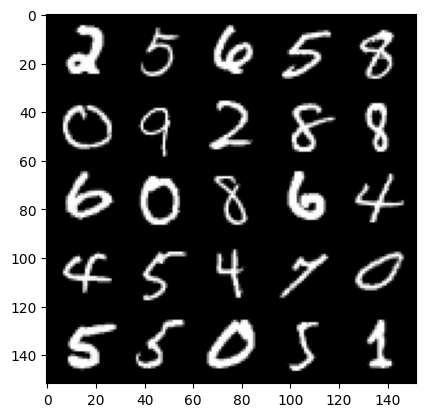

 80%|███████▉  | 375/469 [00:08<00:02, 46.27it/s]

Step 51500: Generator loss: 1.612359076738358, discriminator loss: 0.40153635221719736


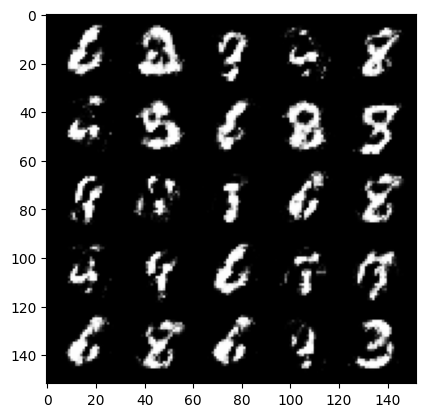

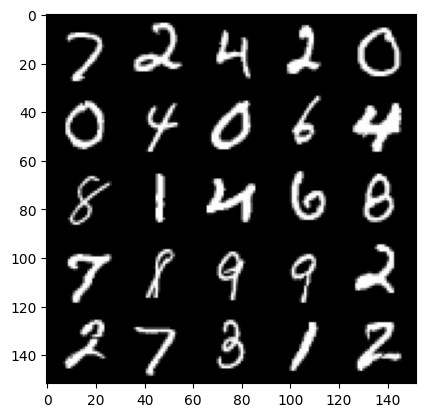

 87%|████████▋ | 410/469 [00:08<00:01, 46.37it/s]

Step 52000: Generator loss: 1.6638203473091135, discriminator loss: 0.38736062216758704


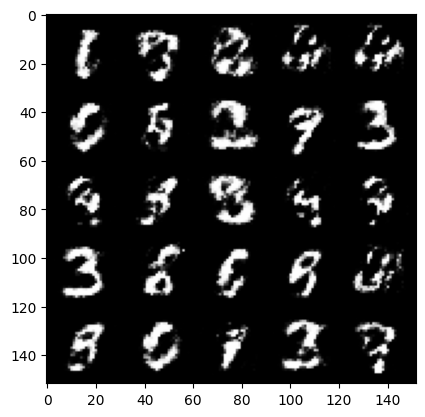

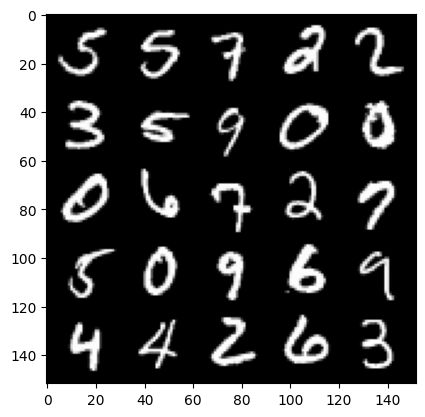

 94%|█████████▍| 440/469 [00:09<00:00, 46.15it/s]

Step 52500: Generator loss: 1.6623060464859, discriminator loss: 0.39510058635473244


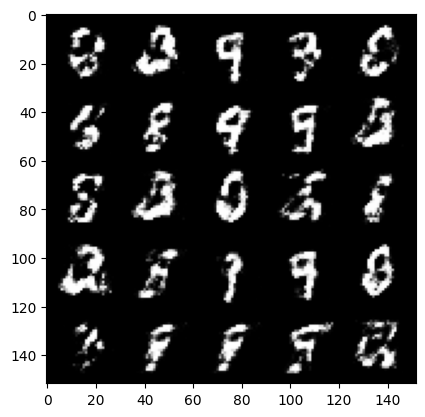

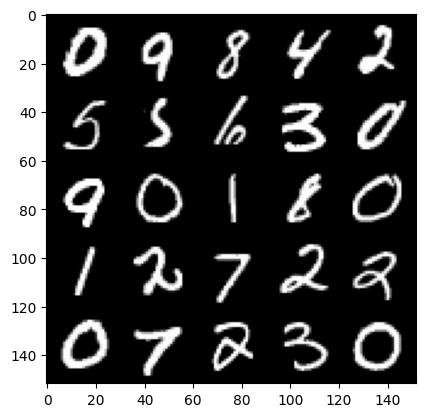

  0%|          | 0/469 [00:00<?, ?it/s]

Step 53000: Generator loss: 1.534262364864349, discriminator loss: 0.4284230906367302


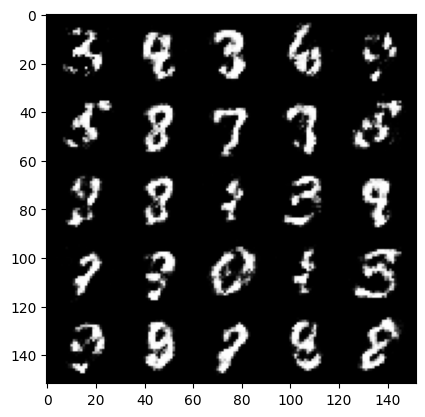

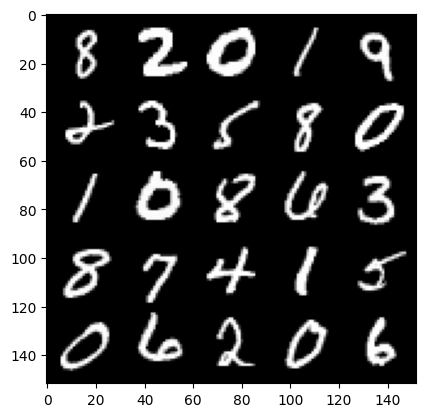

  6%|▋         | 30/469 [00:00<00:09, 44.69it/s]

Step 53500: Generator loss: 1.531434295654297, discriminator loss: 0.41082828819751704


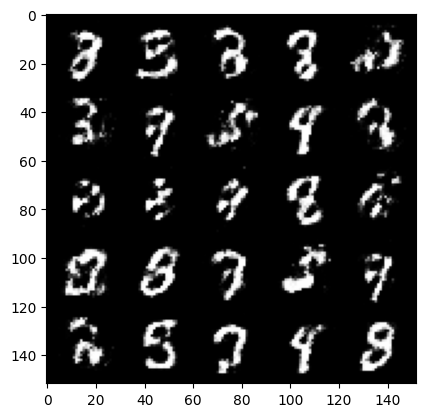

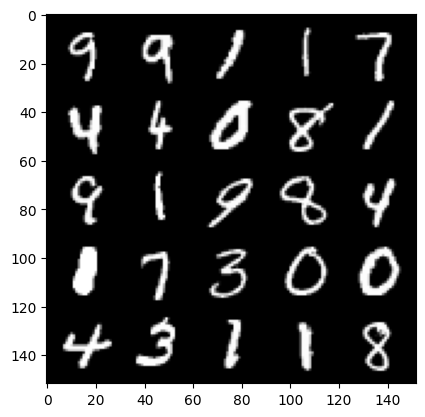

 14%|█▎        | 64/469 [00:01<00:08, 45.93it/s]

Step 54000: Generator loss: 1.61732730937004, discriminator loss: 0.3890441036820415


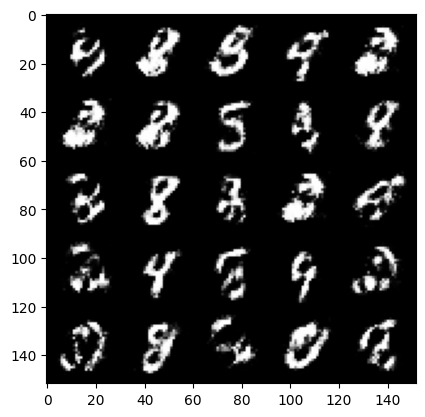

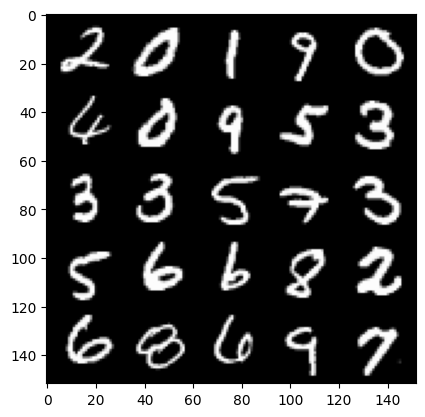

 20%|██        | 95/469 [00:02<00:08, 45.71it/s]

Step 54500: Generator loss: 1.6552037239074702, discriminator loss: 0.3858872409462928


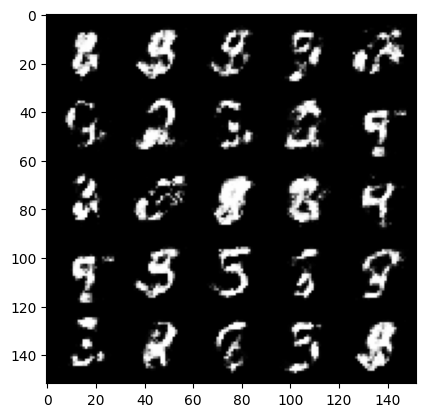

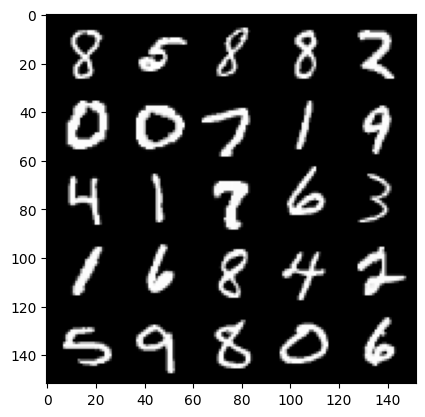

 26%|██▌       | 123/469 [00:02<00:07, 46.66it/s]

Step 55000: Generator loss: 1.5202732670307166, discriminator loss: 0.4160663909912109


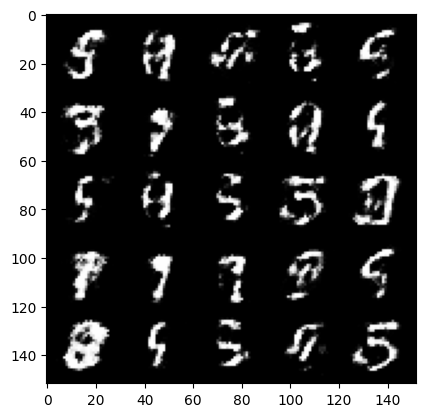

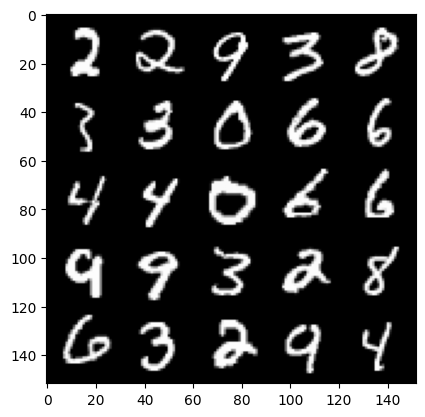

 33%|███▎      | 155/469 [00:03<00:06, 46.17it/s]

Step 55500: Generator loss: 1.5702708685398106, discriminator loss: 0.4036366831064227


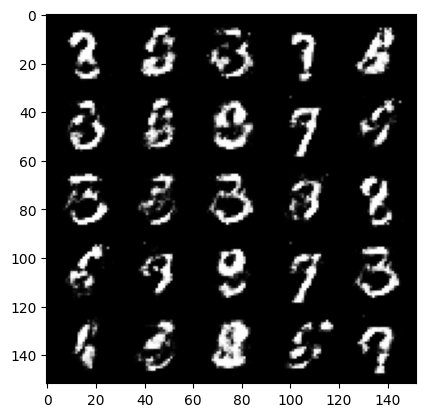

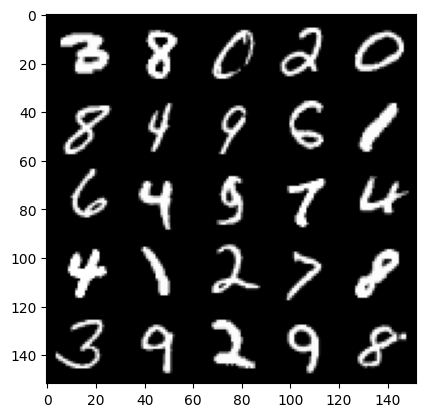

 40%|████      | 189/469 [00:04<00:06, 45.94it/s]

Step 56000: Generator loss: 1.5362986264228824, discriminator loss: 0.41933447170257554


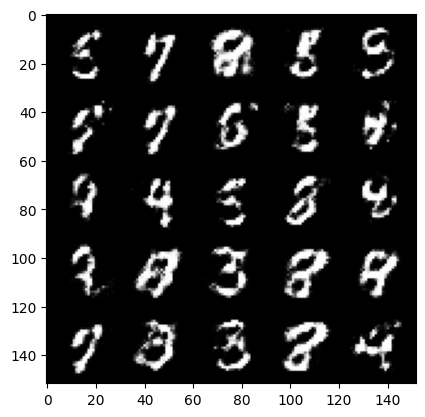

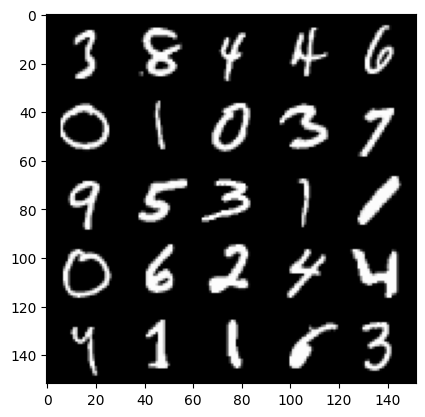

 47%|████▋     | 220/469 [00:05<00:06, 40.17it/s]

Step 56500: Generator loss: 1.4903061790466317, discriminator loss: 0.4235644359588622


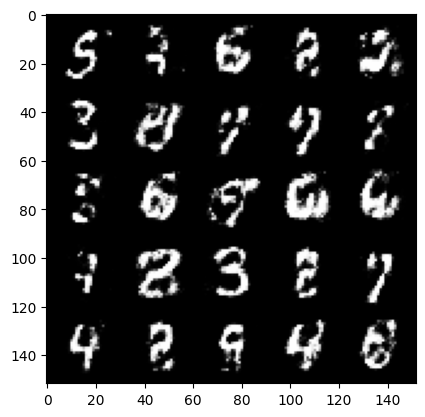

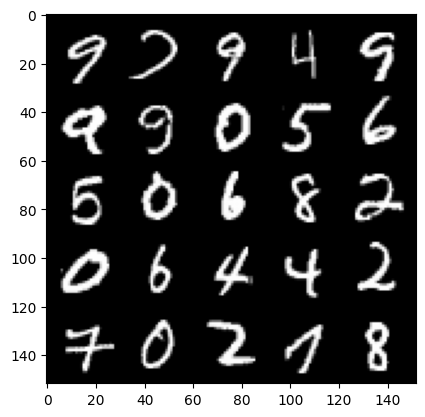

 54%|█████▎    | 251/469 [00:06<00:05, 38.10it/s]

Step 57000: Generator loss: 1.6029480280876163, discriminator loss: 0.3967325843572615


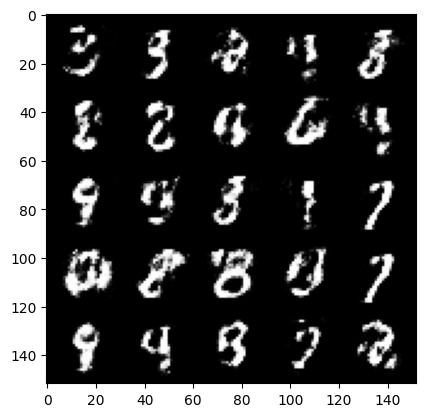

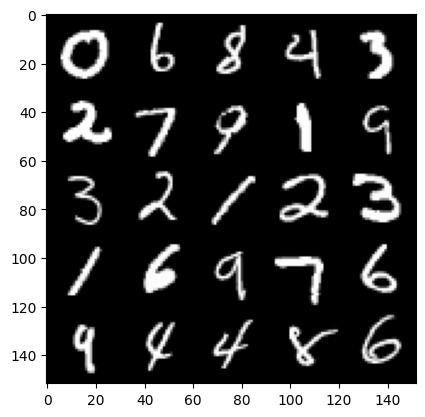

 59%|█████▉    | 279/469 [00:06<00:04, 40.81it/s]

Step 57500: Generator loss: 1.507102279901507, discriminator loss: 0.4296955629587171


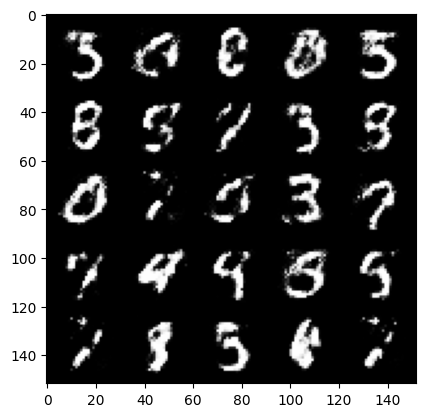

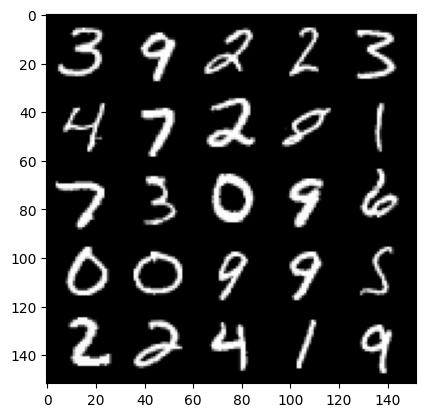

 66%|██████▌   | 310/469 [00:06<00:03, 45.43it/s]

Step 58000: Generator loss: 1.5228560702800746, discriminator loss: 0.41921991789341007


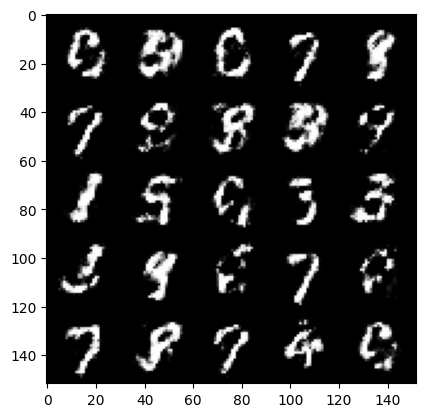

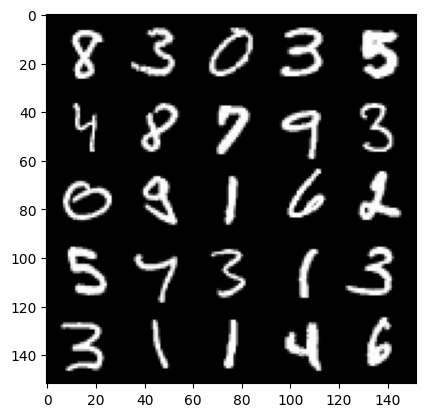

 73%|███████▎  | 344/469 [00:07<00:02, 46.09it/s]

Step 58500: Generator loss: 1.5047554254531863, discriminator loss: 0.4226900300979616


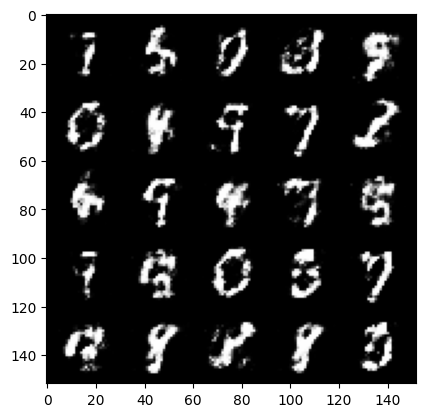

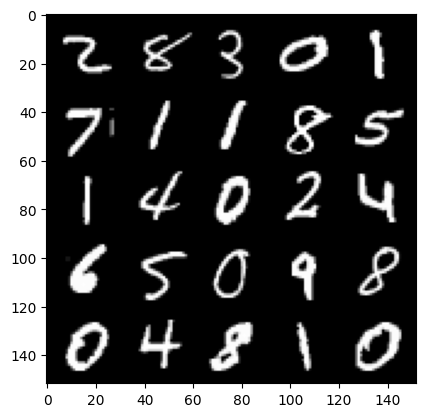

 80%|███████▉  | 373/469 [00:08<00:02, 45.59it/s]

Step 59000: Generator loss: 1.407687680721283, discriminator loss: 0.4720976954102517


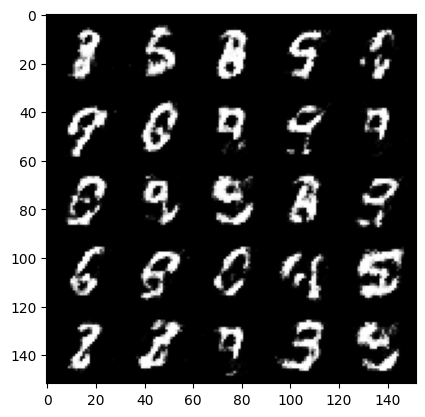

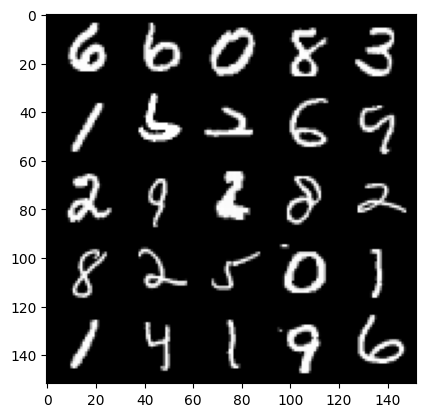

 86%|████████▋ | 405/469 [00:09<00:01, 45.98it/s]

Step 59500: Generator loss: 1.4658449156284337, discriminator loss: 0.43548889315128303


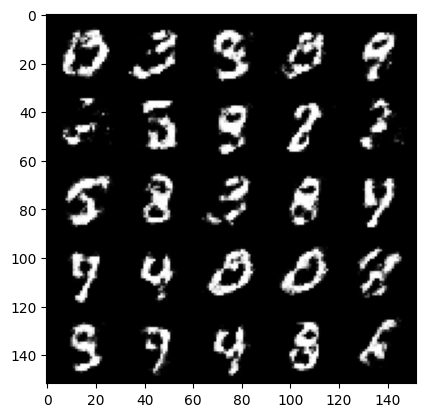

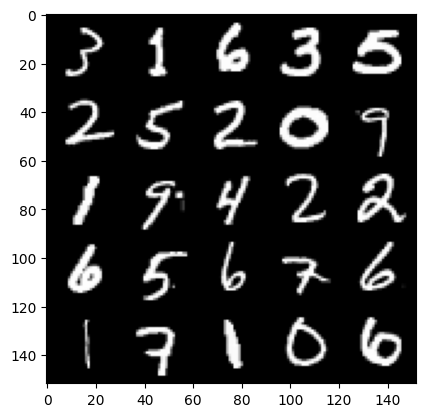

 93%|█████████▎| 435/469 [00:09<00:00, 46.56it/s]

Step 60000: Generator loss: 1.4819790406227118, discriminator loss: 0.4324809666872024


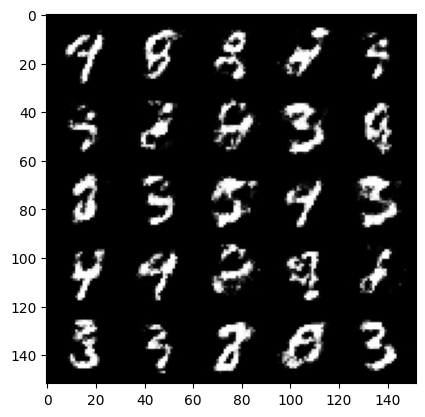

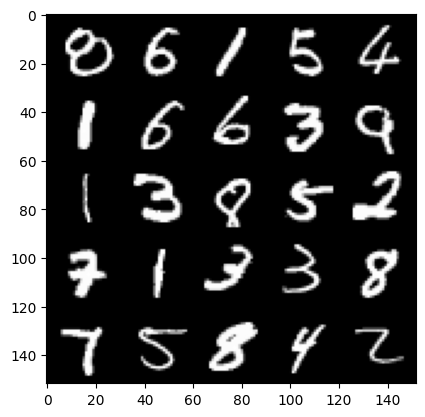

 99%|█████████▉| 465/469 [00:10<00:00, 46.28it/s]

Step 60500: Generator loss: 1.4789078283309942, discriminator loss: 0.43664025032520254


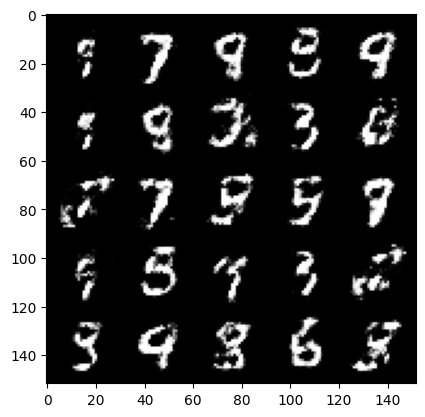

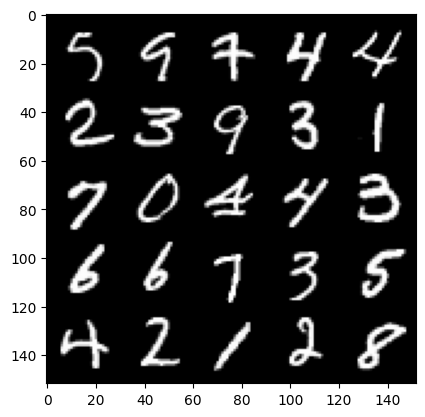

  6%|▋         | 30/469 [00:00<00:09, 45.70it/s]

Step 61000: Generator loss: 1.4203086121082302, discriminator loss: 0.44151448088884315


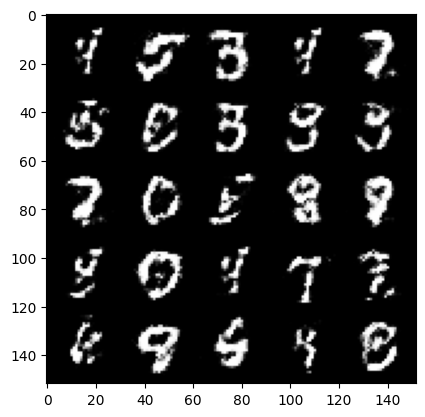

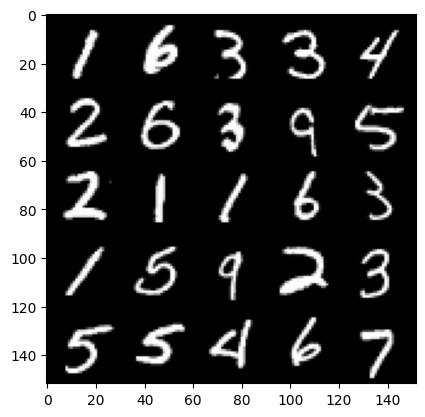

 13%|█▎        | 59/469 [00:01<00:09, 44.82it/s]

Step 61500: Generator loss: 1.5009957368373867, discriminator loss: 0.4106839034557344


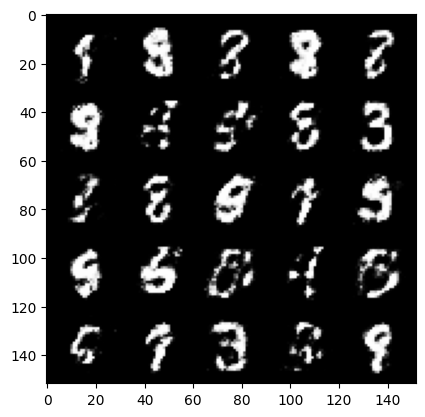

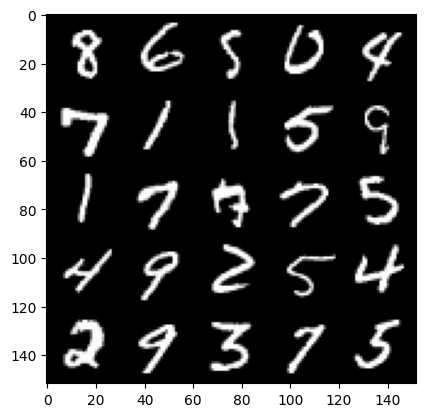

 19%|█▉        | 90/469 [00:01<00:08, 45.62it/s]

Step 62000: Generator loss: 1.4799182858467106, discriminator loss: 0.41430241852998695


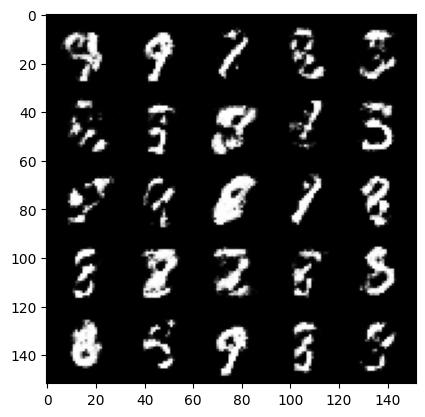

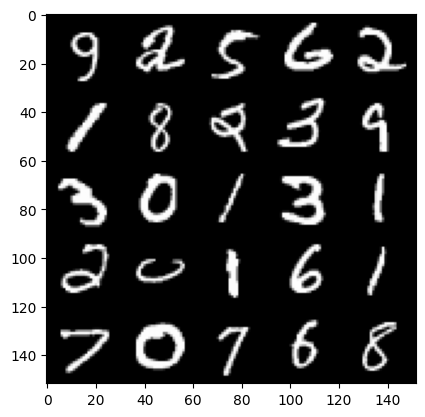

 26%|██▌       | 120/469 [00:02<00:07, 45.65it/s]

Step 62500: Generator loss: 1.4065165927410113, discriminator loss: 0.446346497654915


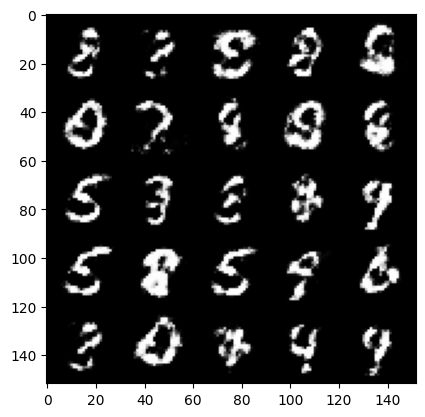

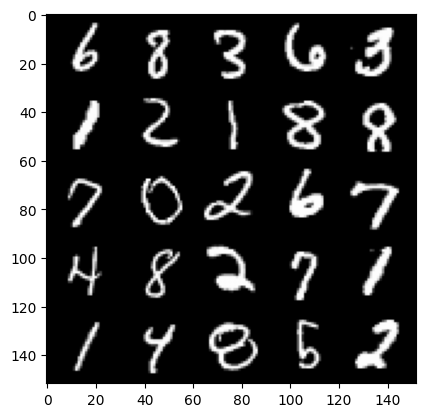

 32%|███▏      | 150/469 [00:03<00:06, 47.77it/s]

Step 63000: Generator loss: 1.417922427177428, discriminator loss: 0.44804700803756736


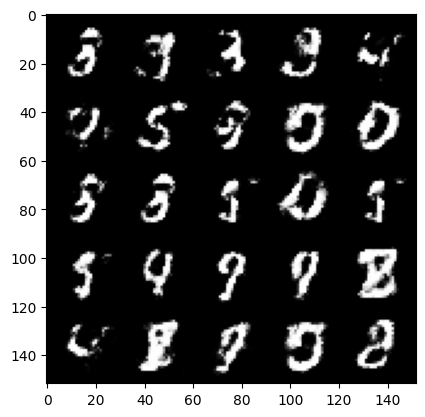

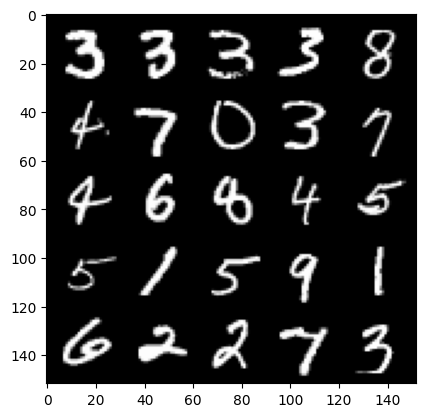

 39%|███▉      | 185/469 [00:03<00:05, 48.96it/s]

Step 63500: Generator loss: 1.3646589477062225, discriminator loss: 0.45277919852733606


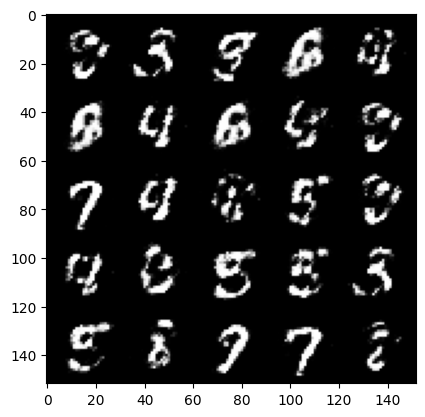

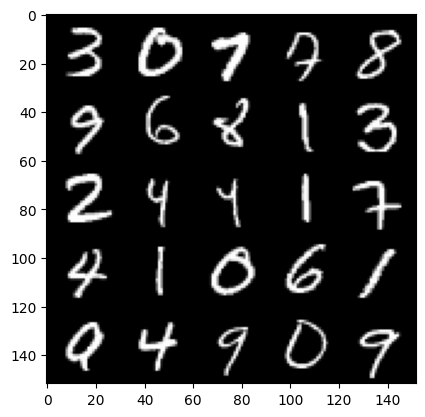

 46%|████▌     | 215/469 [00:04<00:05, 44.28it/s]

Step 64000: Generator loss: 1.4331071603298176, discriminator loss: 0.42482857477664954


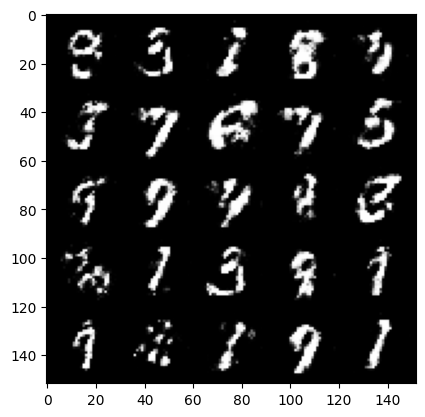

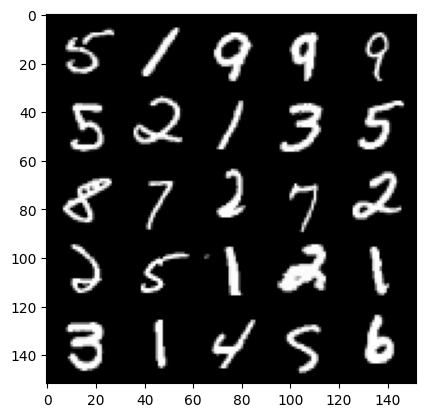

 52%|█████▏    | 245/469 [00:05<00:05, 41.63it/s]

Step 64500: Generator loss: 1.5174801502227777, discriminator loss: 0.41639907145500177


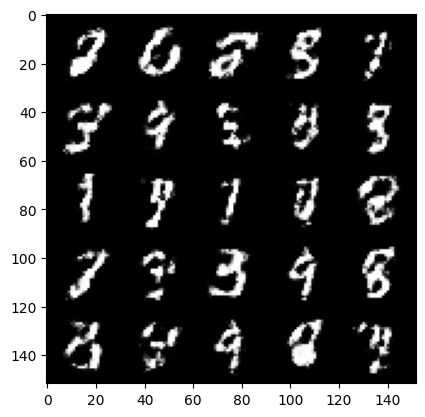

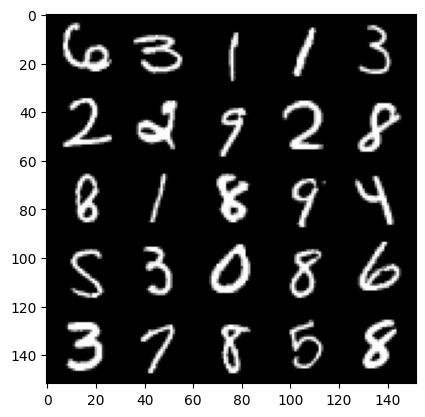

 59%|█████▉    | 277/469 [00:05<00:03, 49.31it/s]

Step 65000: Generator loss: 1.4892547841072084, discriminator loss: 0.4213682211637491


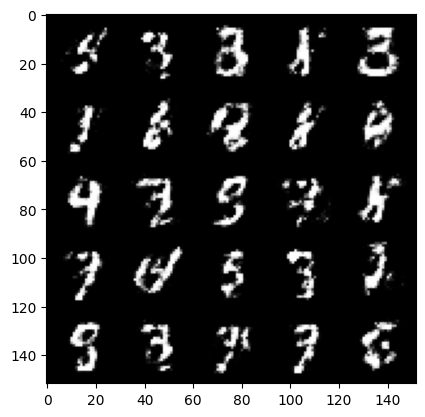

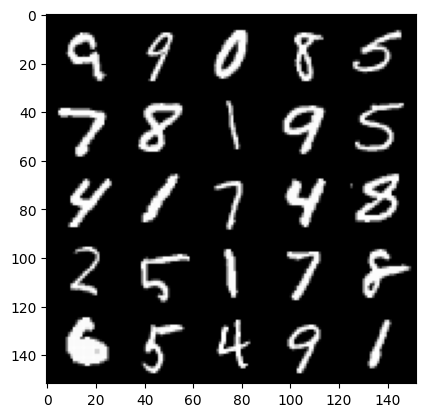

 65%|██████▌   | 305/469 [00:06<00:03, 46.17it/s]

Step 65500: Generator loss: 1.497432999849321, discriminator loss: 0.4422779484987256


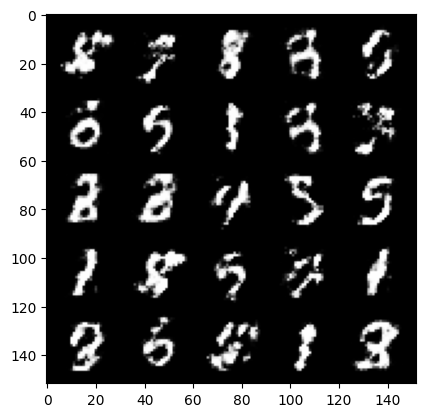

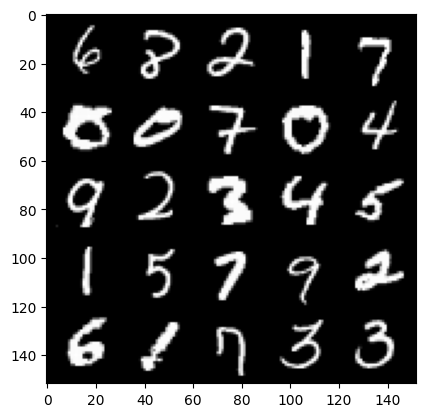

 72%|███████▏  | 338/469 [00:07<00:02, 46.73it/s]

Step 66000: Generator loss: 1.4501475789546967, discriminator loss: 0.4310409755706787


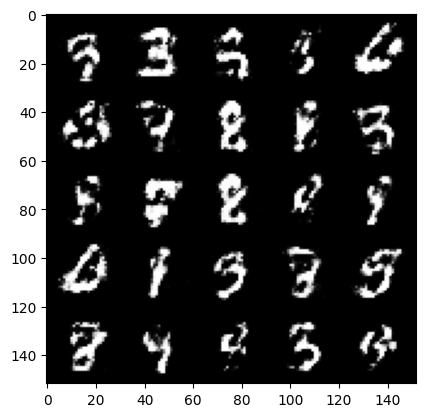

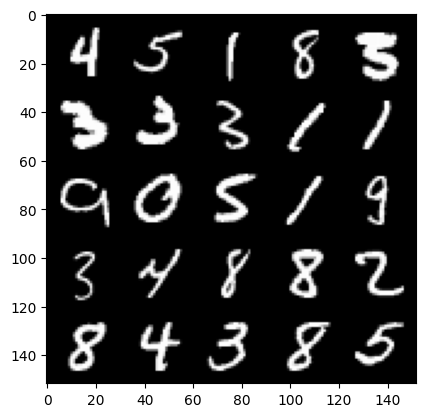

 79%|███████▉  | 370/469 [00:08<00:02, 44.95it/s]

Step 66500: Generator loss: 1.4871309986114516, discriminator loss: 0.42443921226263015


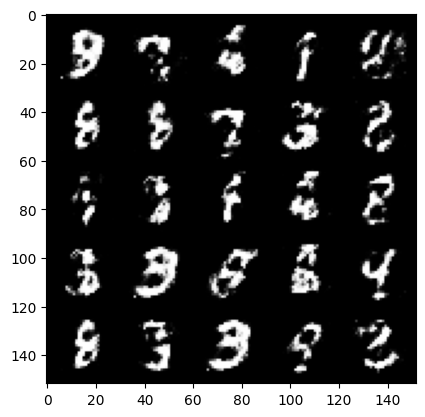

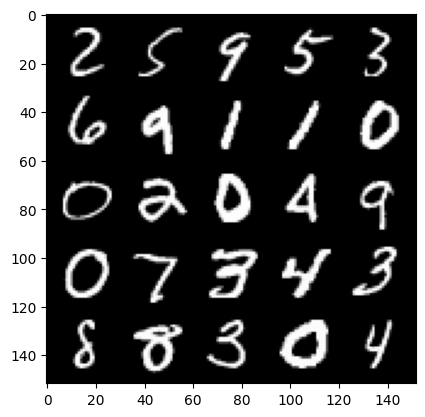

 85%|████████▍ | 398/469 [00:08<00:01, 45.41it/s]

Step 67000: Generator loss: 1.4054825527667998, discriminator loss: 0.449285074353218


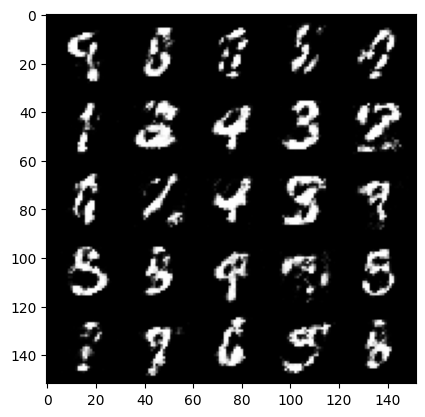

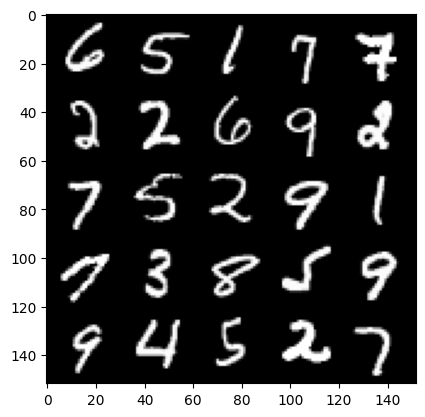

 92%|█████████▏| 431/469 [00:09<00:00, 48.78it/s]

Step 67500: Generator loss: 1.3533749139308935, discriminator loss: 0.4667721341252325


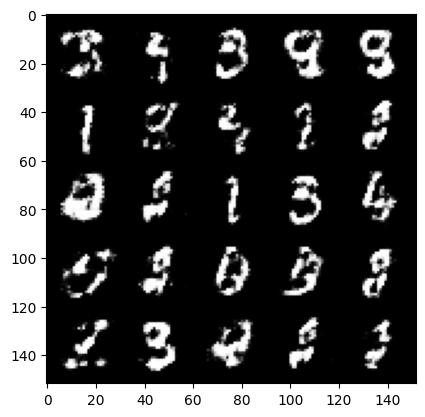

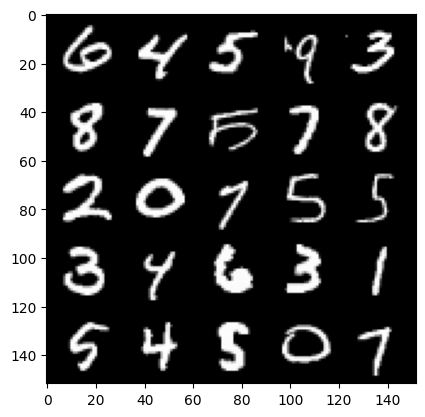

 98%|█████████▊| 461/469 [00:10<00:00, 46.14it/s]

Step 68000: Generator loss: 1.3340643889904038, discriminator loss: 0.4700076021552085


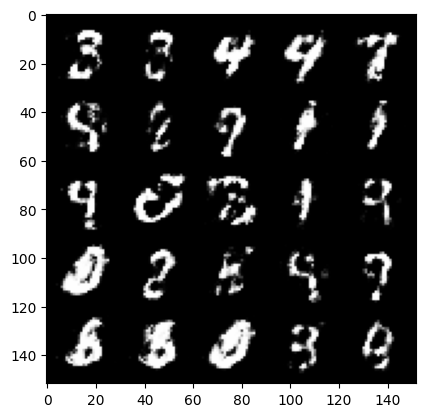

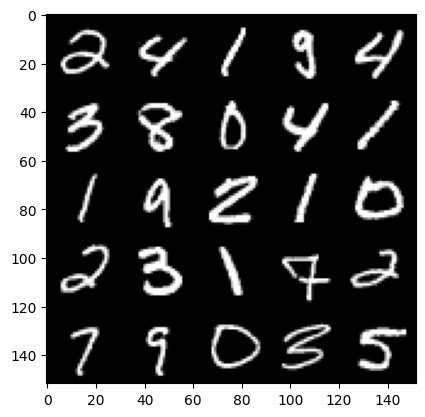

  5%|▌         | 25/469 [00:00<00:09, 45.33it/s]

Step 68500: Generator loss: 1.291385893583299, discriminator loss: 0.4708223969340327


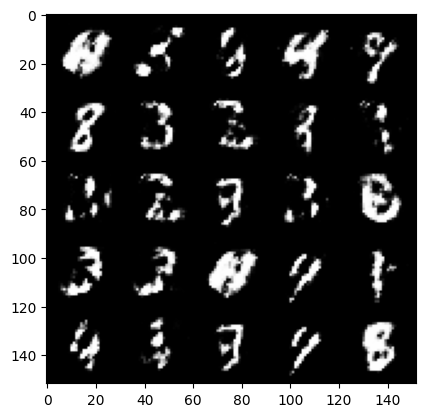

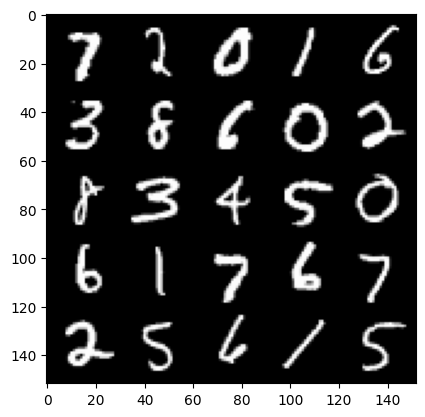

 12%|█▏        | 55/469 [00:01<00:08, 47.45it/s]

Step 69000: Generator loss: 1.3169692003726976, discriminator loss: 0.4733485203385352


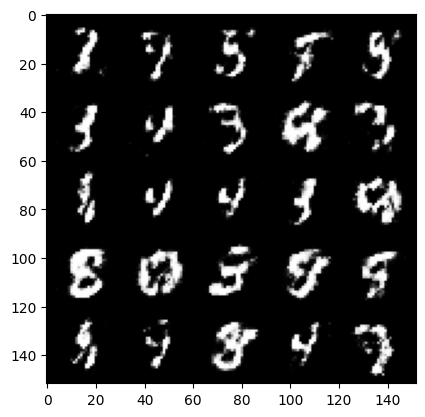

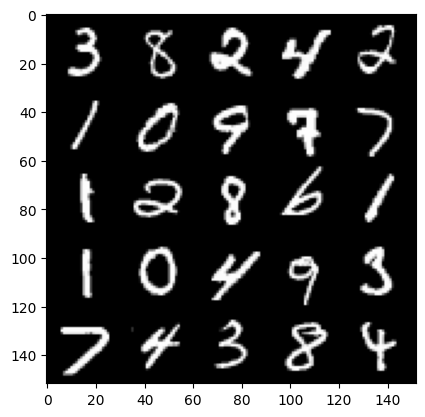

 18%|█▊        | 85/469 [00:01<00:08, 45.89it/s]

Step 69500: Generator loss: 1.3550756349563597, discriminator loss: 0.4713682633638383


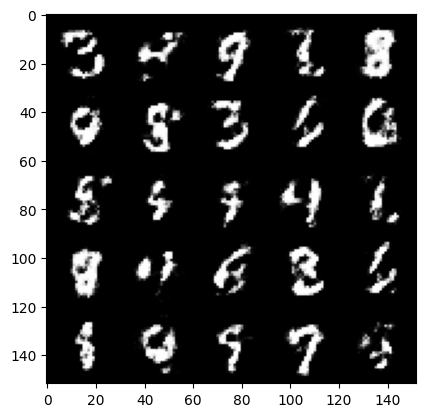

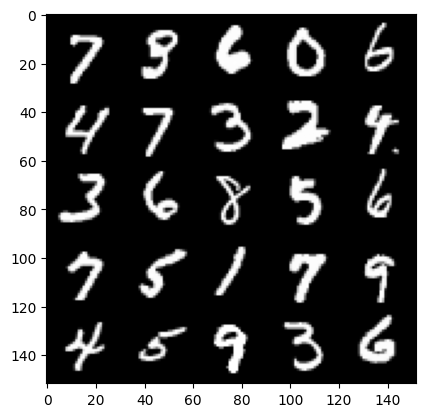

 19%|█▉        | 88/469 [00:01<00:08, 44.97it/s]


KeyboardInterrupt: 

In [24]:
cur_step = 0
mean_generator_loss = 0
mean_discriminator_loss = 0
test_generator = True
gen_loss = False
error = False

for epoch in range(n_epochs):

    for real, _ in tqdm(dataloader):
        cur_batch_size= len(real)

        real = real.view(cur_batch_size, -1).to(device)

        disc_opt.zero_grad()

        disc_loss = get_disc_loss(gen, disc, criterion, real, cur_batch_size, z_dim, device)

        disc_loss.backward(retain_graph = True)

        disc_opt.step()



        gen_opt.zero_grad()

        gen_loss = get_gen_loss(gen,disc, criterion, cur_batch_size, z_dim, device)

        gen_loss.backward()

        gen_opt.step()


        mean_discriminator_loss += disc_loss.item() / display_step
        mean_generator_loss += gen_loss.item() / display_step

        if cur_step % display_step == 0 and cur_step > 0:
            print(f"Step {cur_step}: Generator loss: {mean_generator_loss}, discriminator loss: {mean_discriminator_loss}")
            fake_noise = get_noise(cur_batch_size, z_dim, device=device)
            fake = gen(fake_noise)
            show_tensor_images(fake)
            show_tensor_images(real)
            mean_generator_loss = 0
            mean_discriminator_loss = 0
        cur_step += 1

In [2]:
print("Torch version:",torch.__version__)

print("Is CUDA enabled?",torch.cuda.is_available())

Torch version: 2.0.1+cu117
Is CUDA enabled? True
